In [63]:
import os
import sys
import math
import random
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import ticker
from scipy import stats
from sklearn import datasets
from sklearn import manifold

In [12]:
# path setting
path = os.path.abspath(os.path.dirname(os.getcwd()))
param_path = path + "\\aspect-ratio-parameters"
plot_path = path + "\\aspect-ratio-plots"

**Helper Methods**

In [3]:
def plot_3d_shape(datapoints, colors, title, figsize=(10, 10), set_division=False, save_path=False):
    """
    parameters
        "datapoints": Dataset used to draw the shape.
        "colors": Dataset used to color the shape; can be None.
        "title": Name of the shape.
        "figsize": size of plot, 10 * 10 as default value.
        "set_division": Choose whether set division in each axis scale;
        False as default value; if wanna set division, input real value.
        "save_path": The path for saving the plot; False as default value;
        if wanna to save plot, input absolute path for saving.
    post
        Display and save the plotted shape, generated by sklearn.
    """
    fig = plt.figure(figsize=figsize)  # set figure size
    ax = fig.add_subplot(projection='3d')

    ax.scatter(datapoints.T[0], datapoints.T[1], datapoints.T[2], c=colors)
    plt.title(title, fontsize=20)

    # rotate figure
    ax.view_init(azim=-60, elev=9)
    
    if set_division != False:
        # set division in each axis scale
        ax.xaxis.set_major_locator(ticker.MultipleLocator(set_division))
        ax.yaxis.set_major_locator(ticker.MultipleLocator(set_division))
        ax.zaxis.set_major_locator(ticker.MultipleLocator(set_division))
    
    if save_path != False:
        plt.savefig(save_path)
    plt.show()


def plot_2d_shape_single(datapoints, colors, title, figsize=(10, 10), set_division=False, save_path=False):
    """
    parameters
        "datapoints": Dataset used to draw the shape, a matrix with 2 columns,
        returned from sklearn manifold learning methods.
        "colors": Dataset used to color the shape; can be None.
        "title": Name of the shape.
        "figsize": size of plot, 10 * 10 as default value.
        "set_division": Choose whether set division in each axis scale;
        False as default value; if wanna set division, input real value.
        "save_path": The path for saving the plot; False as default value;
        if wanna to save plot, input absolute path for saving.
    post
        Plot and save the 2d shape, through data in "datapoints".
    """
    x, y = datapoints.T
    plt.figure(figsize=figsize)
    plt.scatter(x, y, c=colors, s=50, alpha=0.8)
    plt.title(title, fontsize=20)

    if set_division != False:
        # set division in each axis scale
        ax.xaxis.set_major_locator(ticker.MultipleLocator(set_division))
        ax.yaxis.set_major_locator(ticker.MultipleLocator(set_division))

    if save_path != False:
        plt.savefig(save_path)
    plt.show()


def plot_2d_shape_all(datapoints, colors, title, figsize=(20, 20), set_division=False, save_path=False):
    """
    parameters
        "datapoints": Returned matrix from sklearn manifold learning methods, for plotting.
        "colors": Dataset used to color each shape; can be None.
        "title": Name of the plot.
        "figsize": size of plot, 20 * 20 as default value.
        "set_division": Choose whether set division in each axis scale;
        False as default value; if wanna set division, input real value.
        "save_path": The path for saving the plot; False as default value;
        if wanna to save plot, input absolute path for saving.
    post
        Plot and save all 2d shapes; each shape is plotted by combining first and
        another column in "datapoints".
    """
    num_of_plots = datapoints.shape[-1] - 1
    fig = plt.figure(figsize=figsize)
    
    for i in range(1, num_of_plots+1):
        sub_data = datapoints[:, [0,i]]
        x, y = sub_data.T
        ax = fig.add_subplot(math.ceil(num_of_plots/2), 2, i)
        ax.scatter(x, y, c=colors)
        ax.set_title("v0, v"+str(i))

        if set_division != False:
            # set division in each axis scale
            ax.xaxis.set_major_locator(ticker.MultipleLocator(set_division))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(set_division))
    
    plt.suptitle(title, fontsize=20)
    if save_path != False:
        plt.savefig(save_path)
    plt.show()

**Swiss Roll, Isomap**

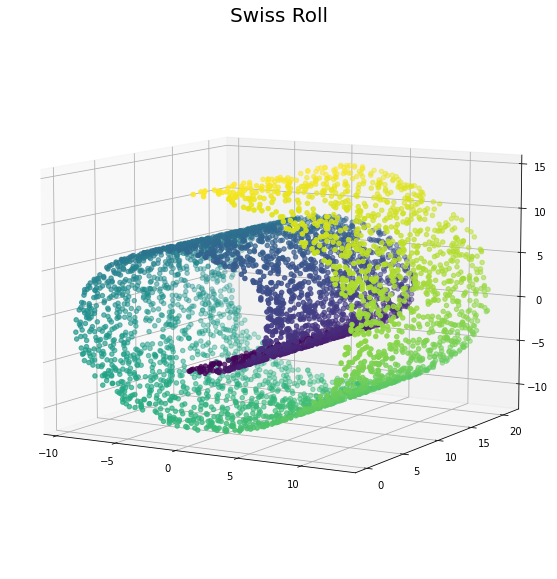

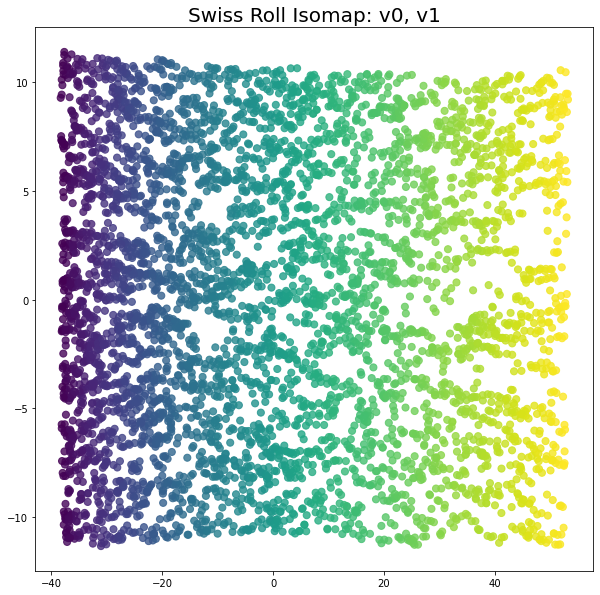

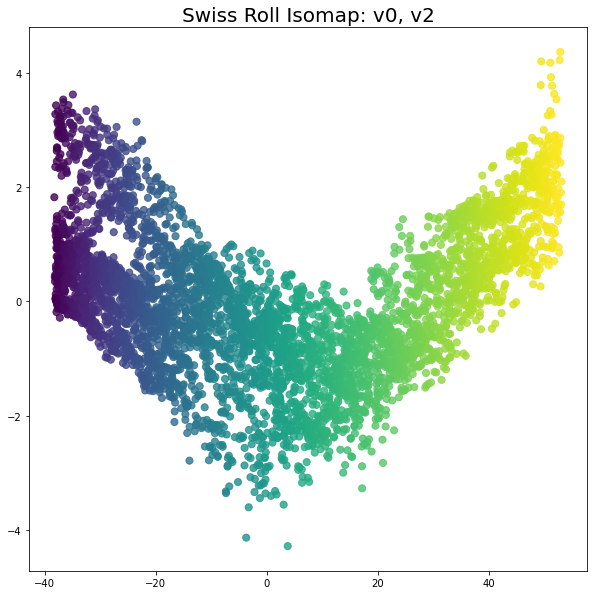

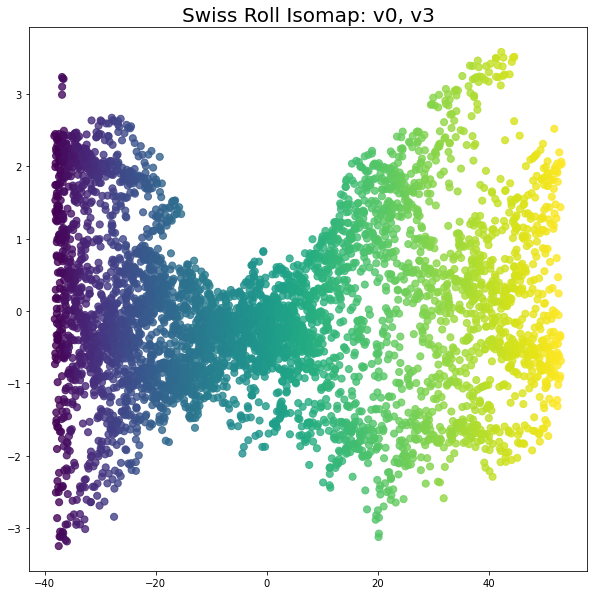

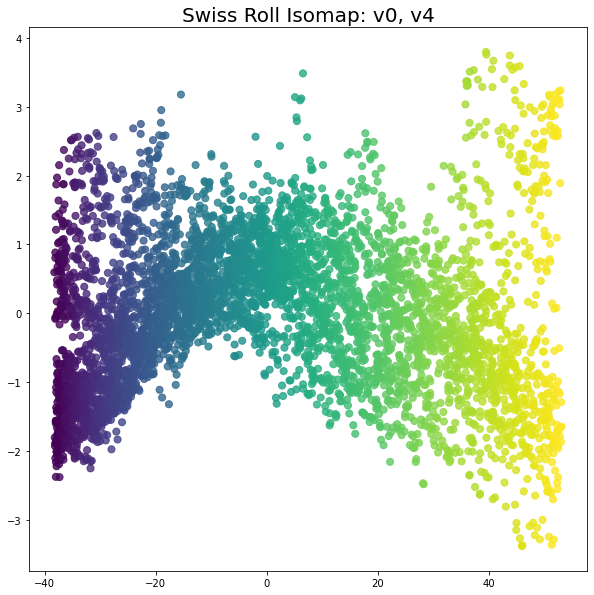

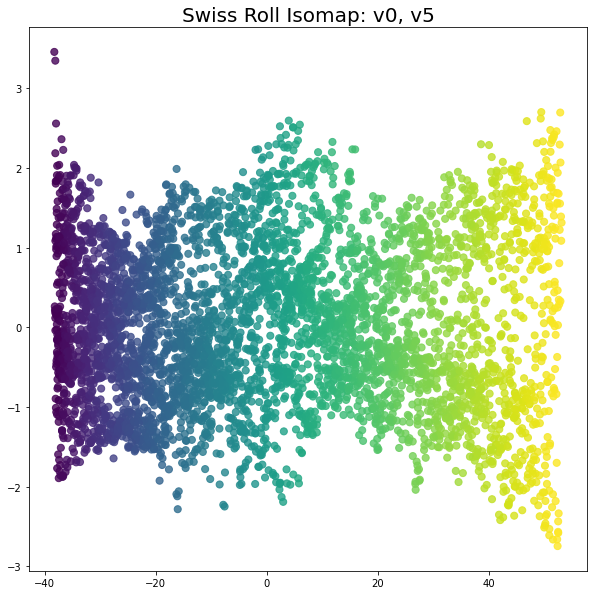

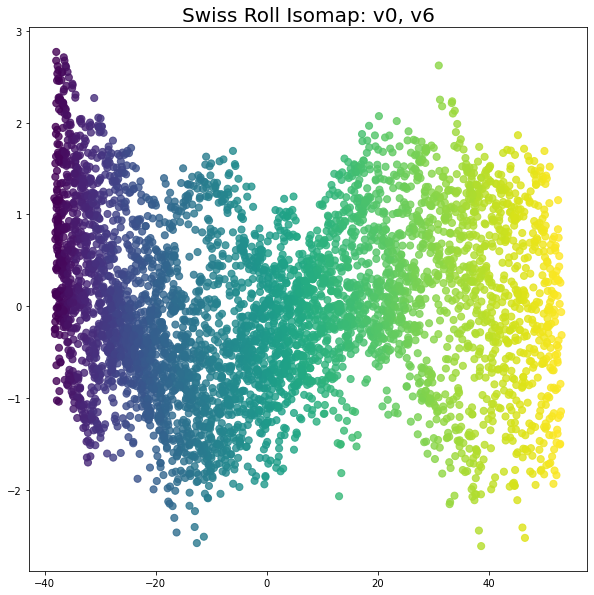

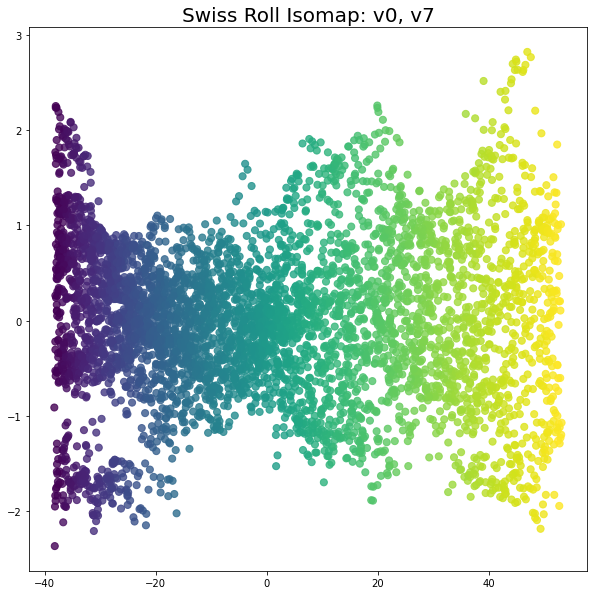

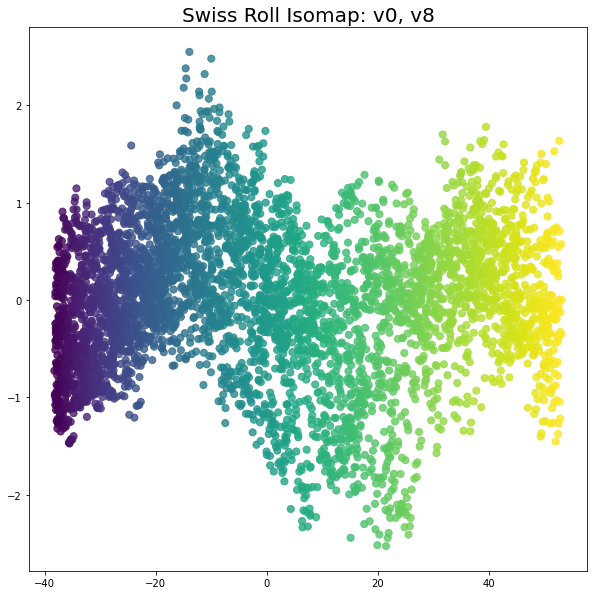

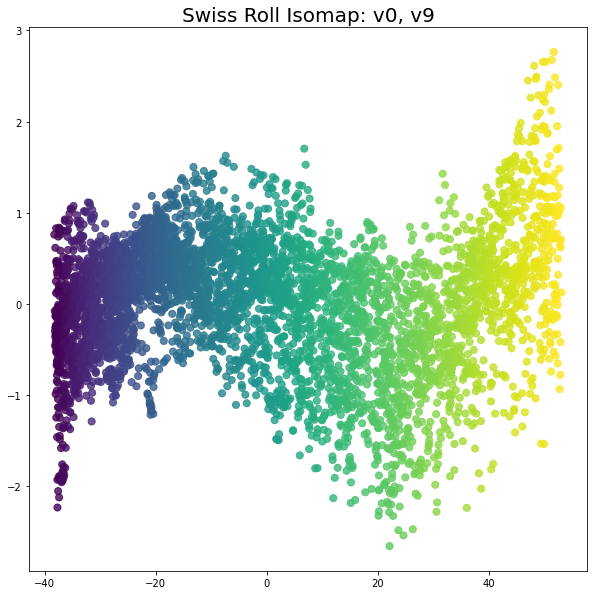

In [8]:
shape_name = "Swiss Roll"

# generate datapoints
n_samples = 5000
data, color = datasets.make_swiss_roll(n_samples=n_samples, random_state=1, noise=0, hole=False)

# display and save the generated shape
plot_3d_shape(data, color, shape_name,
    save_path=plot_path + "\\" + shape_name + ".jpg")

# Isomap embedding
n_neighbors = 12
n_components = 10
isomap = manifold.Isomap(n_neighbors=n_neighbors, n_components=n_components)
data_isomap = isomap.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_isomap[:, [0,i]], color,
        shape_name + " Isomap:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Isomap_" + "_v0_" + "_v" + str(i) + ".jpg")

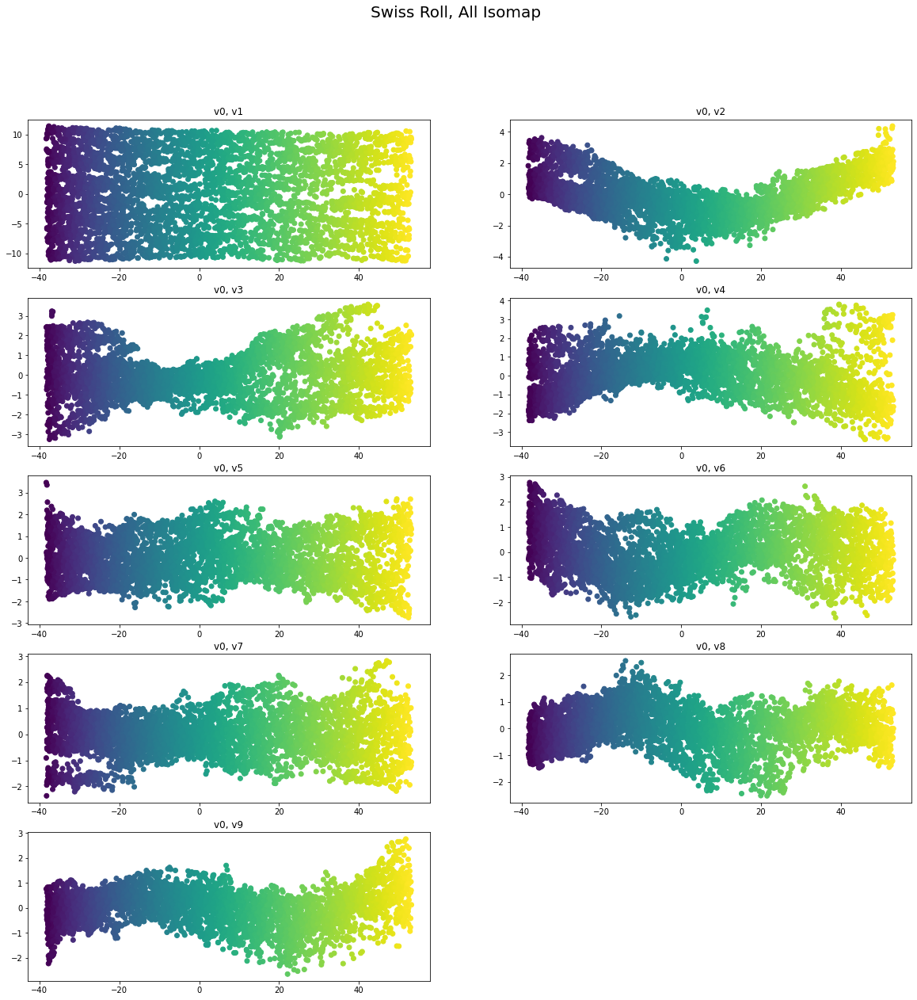

In [11]:
# all combinations, in one plot
plot_2d_shape_all(data_isomap, color, "Swiss Roll, All Isomap",
    save_path=plot_path + "\\" + shape_name + "_All_Isomap.jpg")

We can see that among all combinations of Isomap results for Swiss Roll, **(v0, v1)** columns gives the best result; we will save them as parameter results.

In [19]:
# save parameters into txt
np.savetxt(param_path+"\\Swiss_Roll_Isomap.txt", data_isomap[:, [0,1]])

**Swiss Roll, Spectral Embedding**

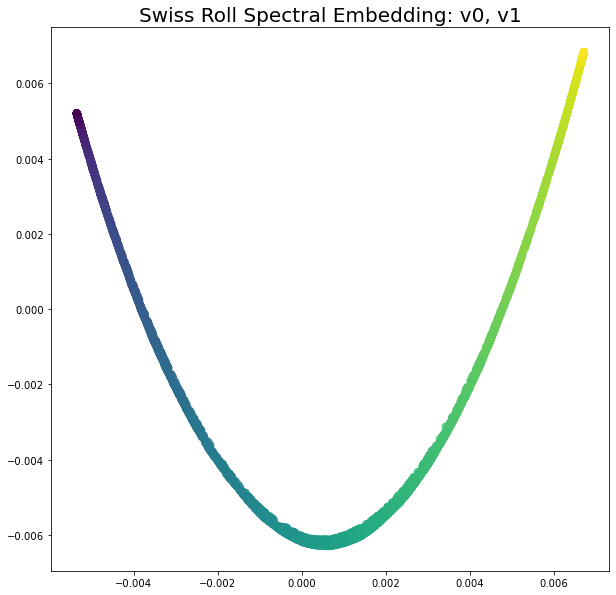

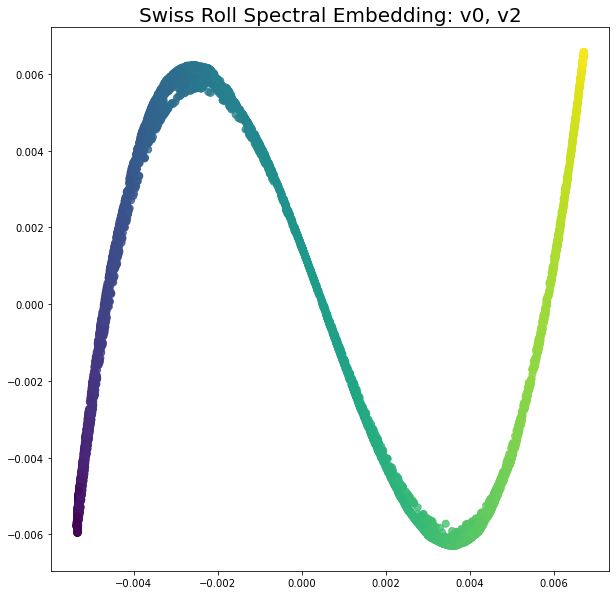

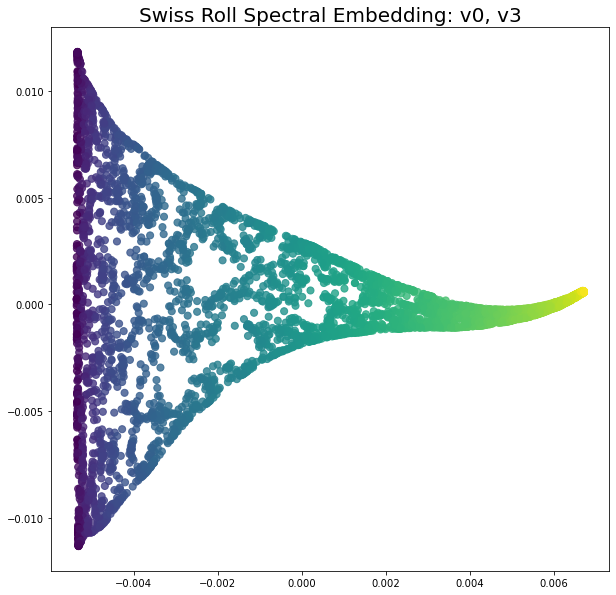

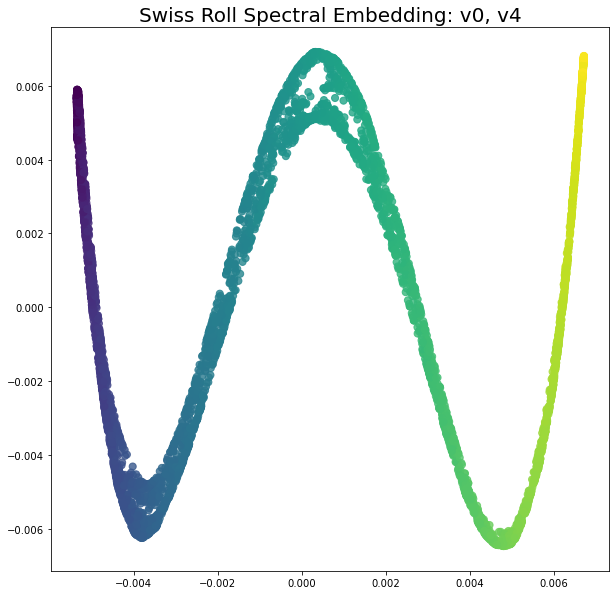

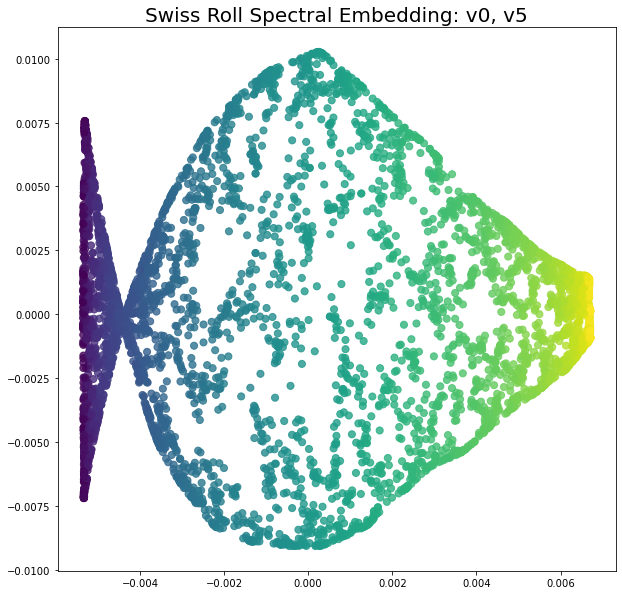

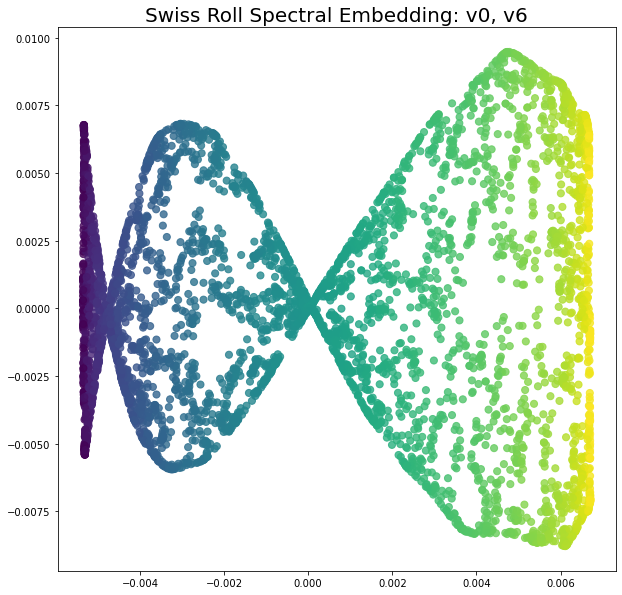

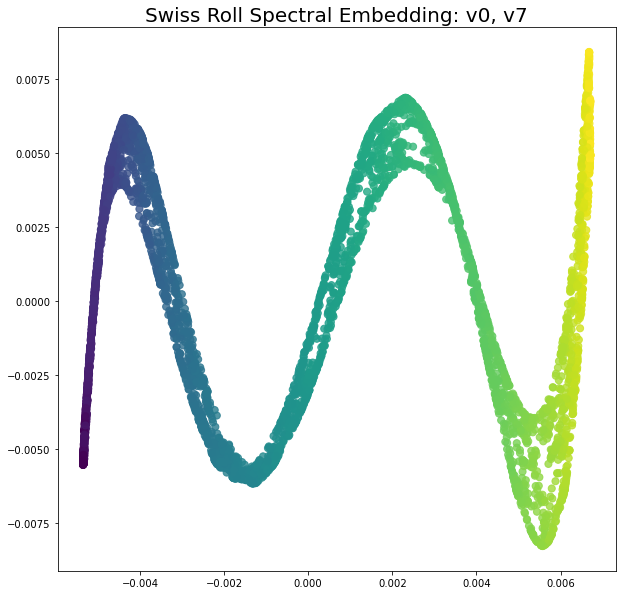

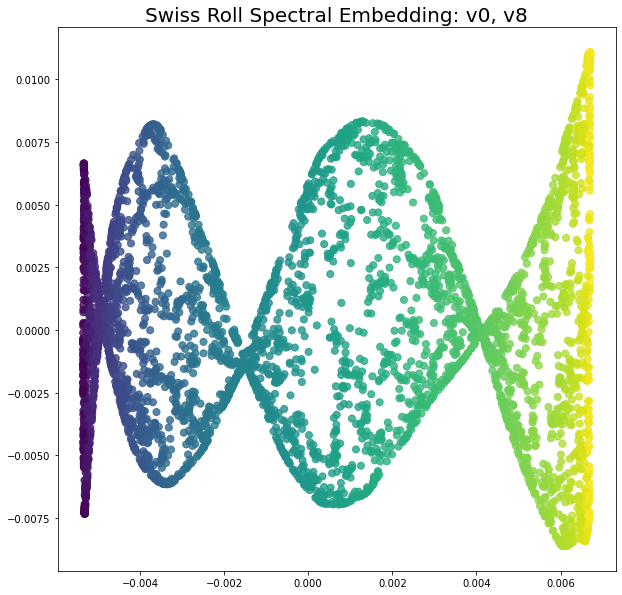

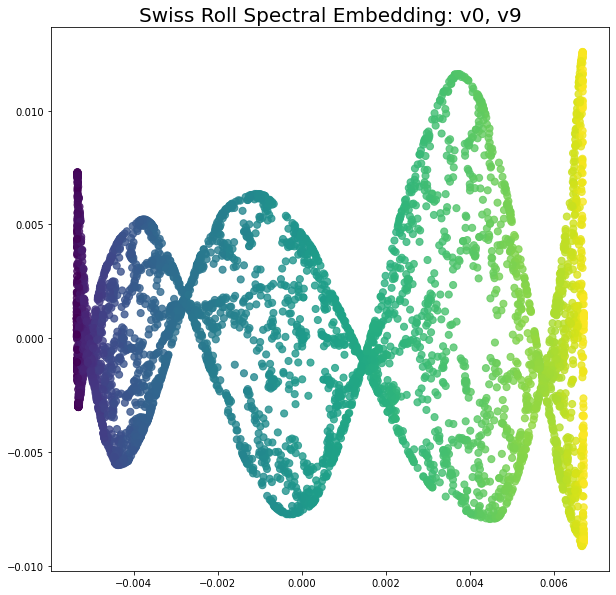

In [21]:
# Spectral embedding
n_neighbors = 12
n_components = 10
spectral = manifold.SpectralEmbedding(n_components=n_components, n_neighbors=n_neighbors)
data_spectral = spectral.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_spectral[:, [0,i]], color,
        shape_name + " Spectral Embedding:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Spectral_Embedding_" + "_v0_" + "_v" + str(i) + ".jpg")

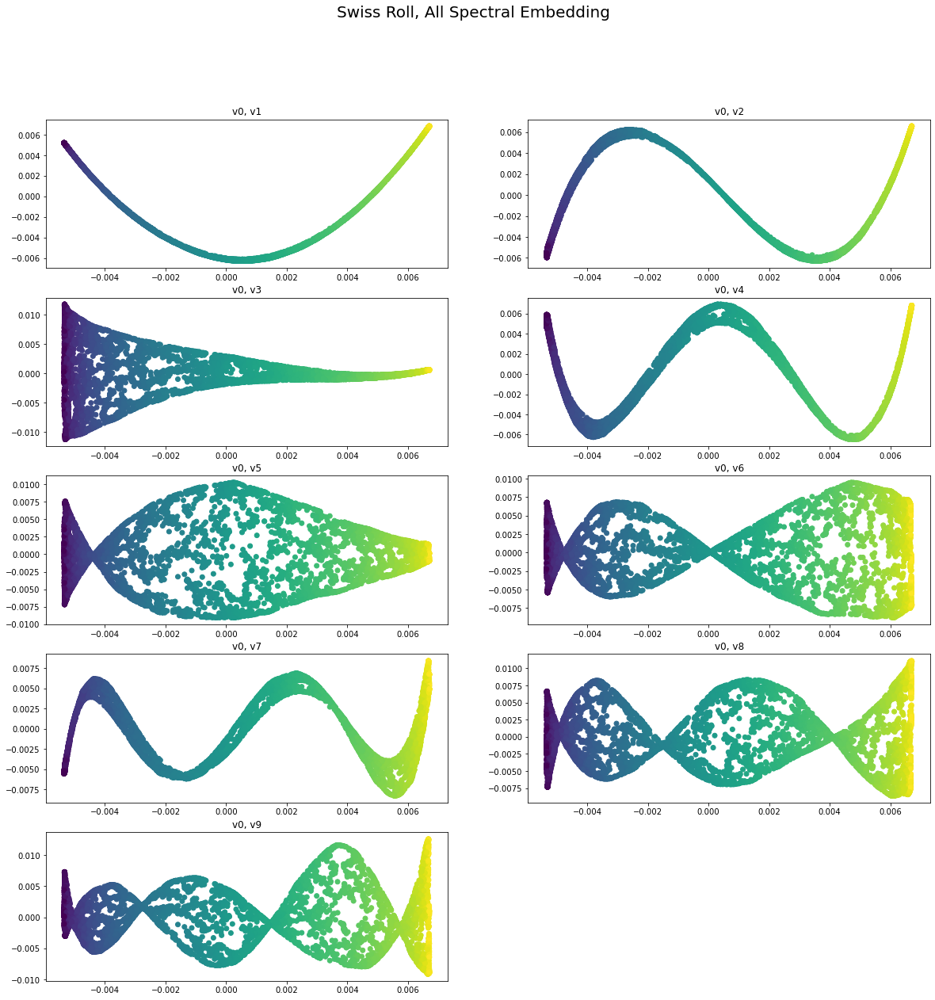

In [22]:
# all combinations, in one plot
plot_2d_shape_all(data_spectral, color, "Swiss Roll, All Spectral Embedding",
    save_path=plot_path + "\\" + shape_name + "_All_Spectral_Embedding.jpg")

We can see that among all combinations of Spectral Embedding results for Swiss Roll, **(v0, v3)** columns gives the best result, very similar to a triangle. In comparison, combinations such as (v0, v1), (v0, v2), (v0, v4) are more similar to lines in 1d.

In [75]:
# save parameters into txt
np.savetxt(param_path+"\\Swiss_Roll_Spectral_Embedding.txt", data_spectral[:, [0,3]])

**Torus, Isomap**

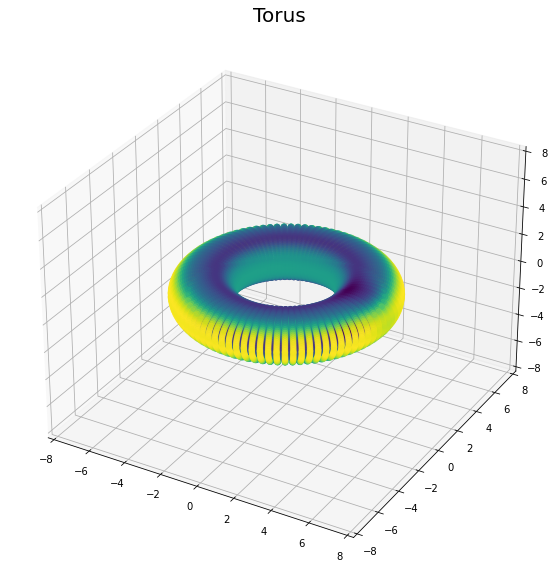

In [49]:
shape_name = "Torus"

# generate datapoints
n = 90
theta = np.linspace(0, 2.*np.pi, n)
phi = np.linspace(0, 2.*np.pi, n)
theta, phi = np.meshgrid(theta, phi)
c, a = 4, 1.5
x = (c + a*np.cos(theta)) * np.cos(phi)
y = (c + a*np.cos(theta)) * np.sin(phi)
z = a * np.sin(theta)

torus = [x, y, z]
torus = np.reshape(torus, (3,n**2))
torus = np.append(torus, [[0]*n**2]*17, 0)
xyz = np.vstack([torus[0,:], torus[1,:], torus[2,:]])
density = stats.gaussian_kde(xyz)(xyz) 
idx = density.argsort()
x, y, z, density = torus[0,:][idx], torus[1,:][idx], torus[2,:][idx], density[idx]

data = np.array([x, y, z]).T
color = -density

# display and save the generated shape
fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection="3d")
ax.scatter(x, y, z, c=color, s=30, alpha=0.6)
ax.set_title("Torus", fontsize=20)
ax.axes.set_xlim3d(left=-2*c, right=2*c) 
ax.axes.set_ylim3d(bottom=-2*c, top=2*c) 
ax.axes.set_zlim3d(bottom=-2*c, top=2*c)
plt.savefig(plot_path + "\\" + shape_name + ".jpg")
plt.show()

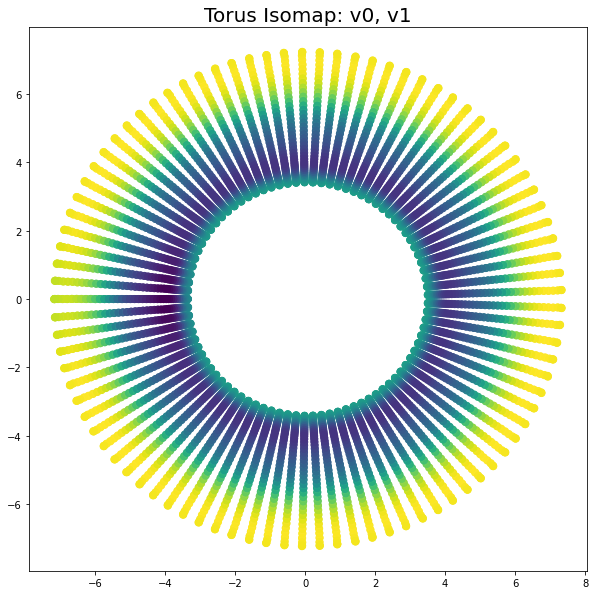

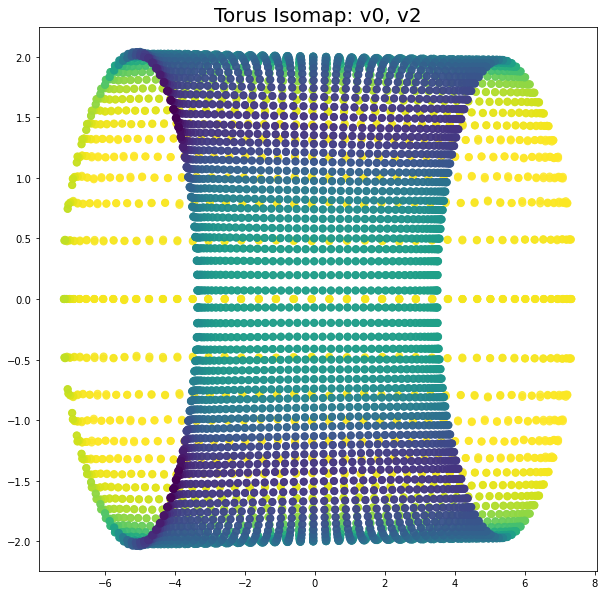

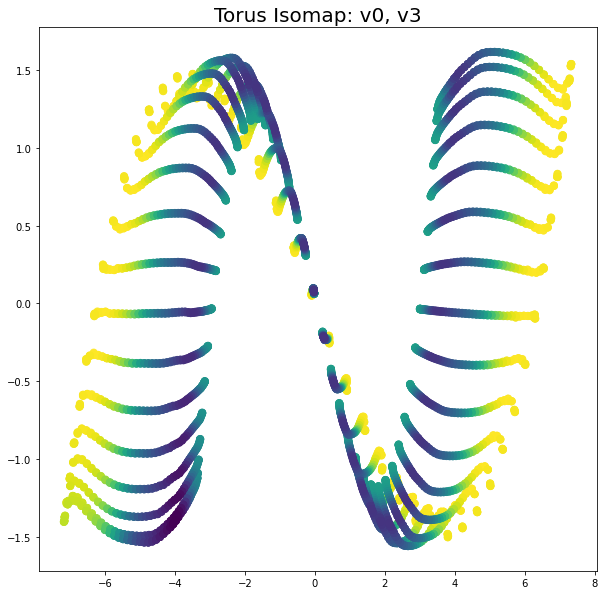

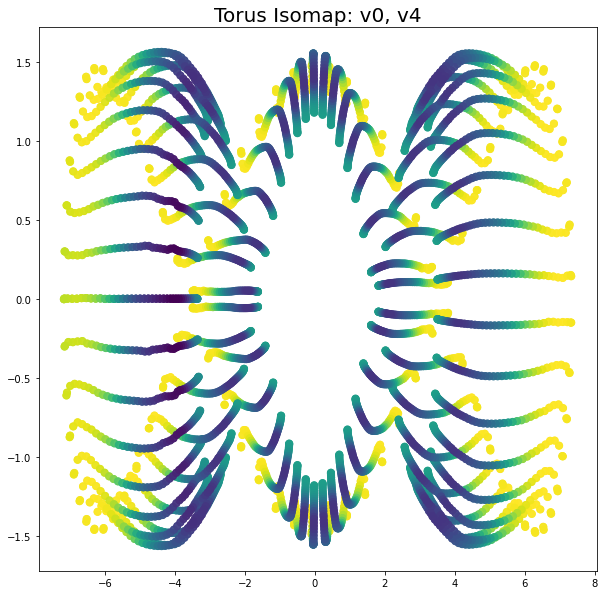

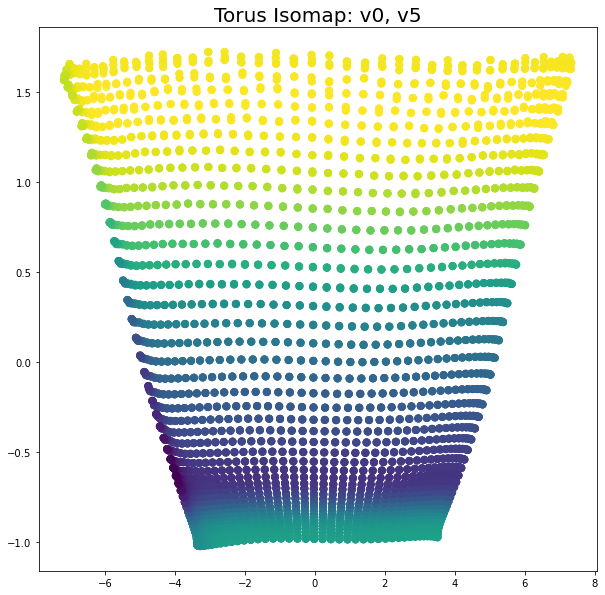

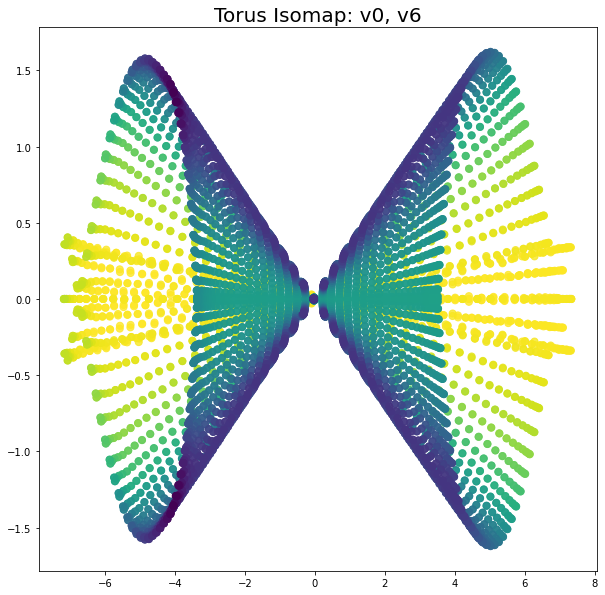

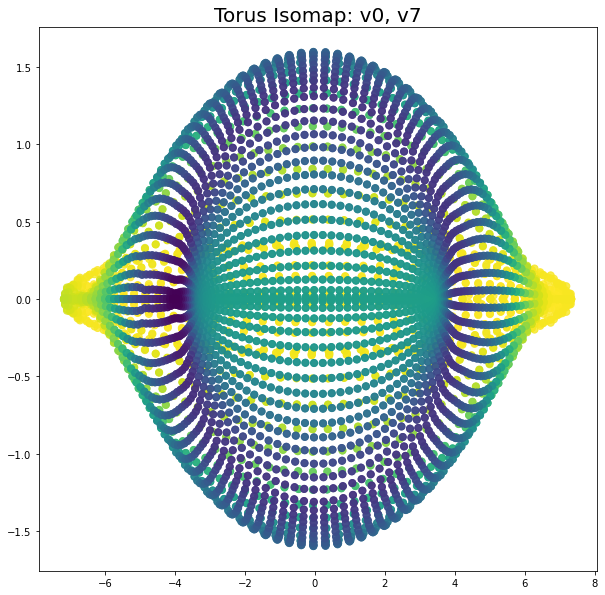

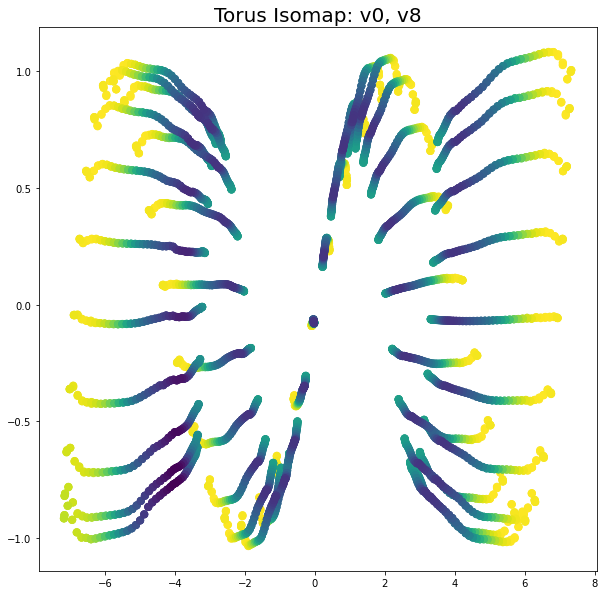

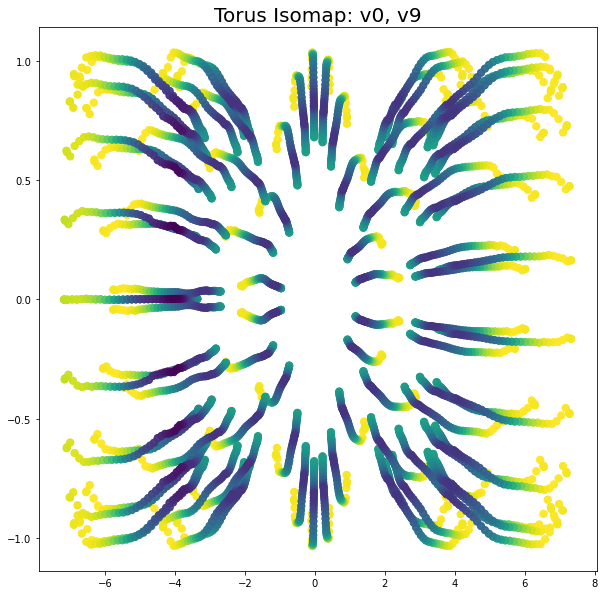

In [50]:
# Isomap embedding
n_neighbors = 12
n_components = 10
isomap = manifold.Isomap(n_neighbors=n_neighbors, n_components=n_components)
data_isomap = isomap.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_isomap[:, [0,i]], color,
        shape_name + " Isomap:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Isomap_" + "_v0_" + "_v" + str(i) + ".jpg")

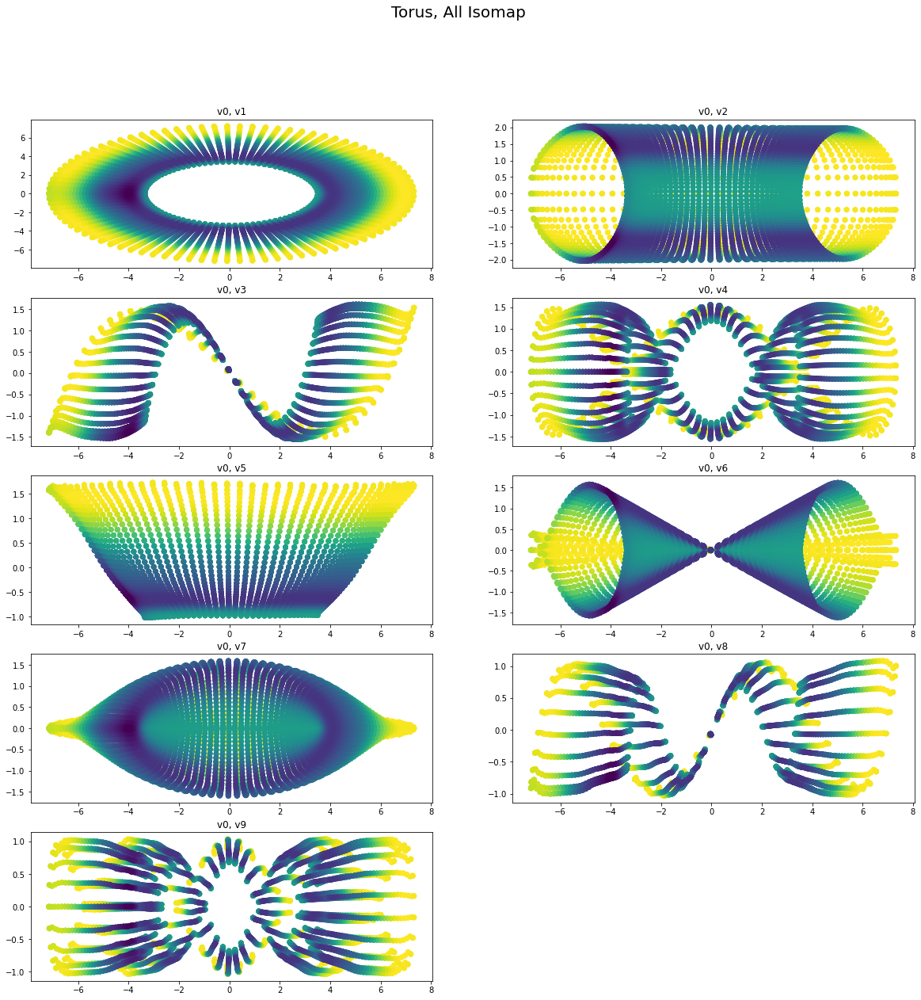

In [52]:
# all combinations, in one plot
plot_2d_shape_all(data_isomap, color, "Torus, All Isomap",
    save_path=plot_path + "\\" + shape_name + "_All_Isomap.jpg")

We can see that among all combinations of Isomap results for Torus, **(v0, v5)** columns gives the best result, very similar to a trapezoid, a shape in 2d.

In [58]:
# save parameters into txt
np.savetxt(param_path+"\\Torus_Isomap.txt", data_isomap[:, [0,5]])

**Torus, Spectral Embedding**

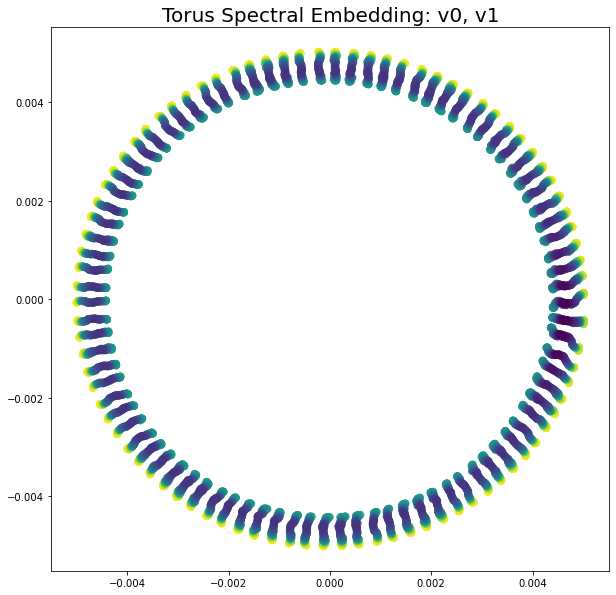

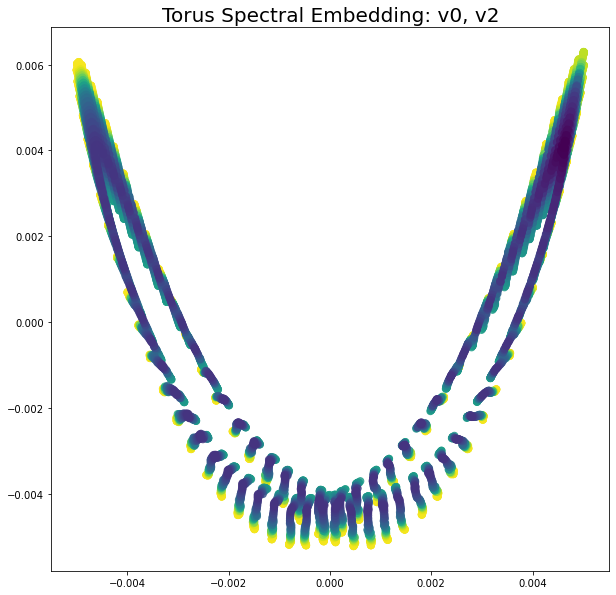

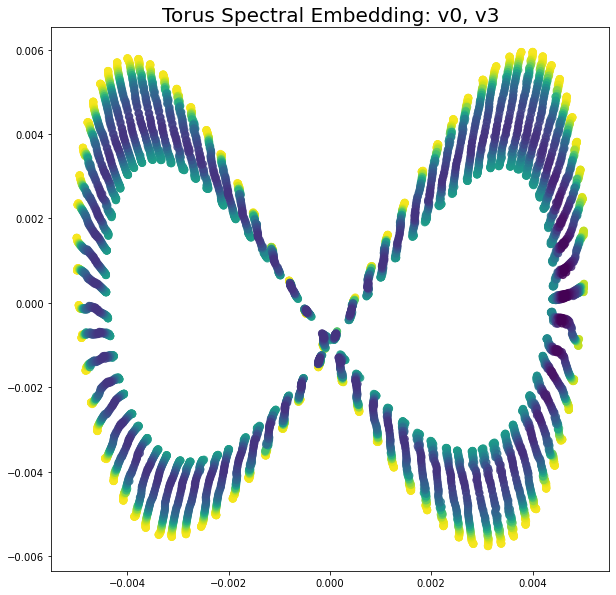

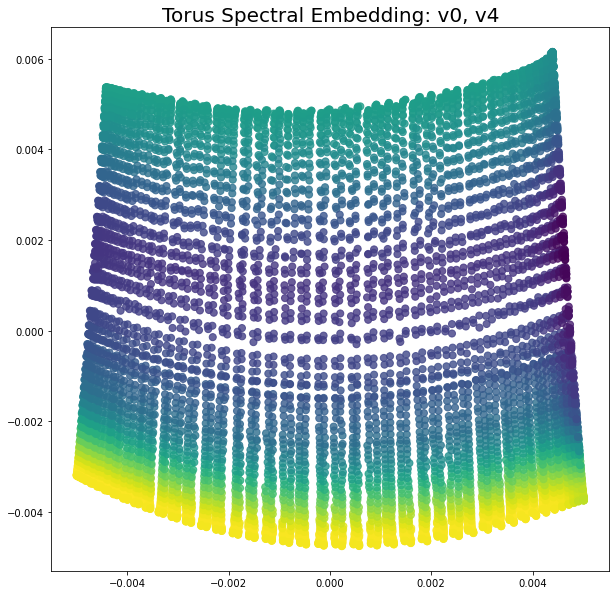

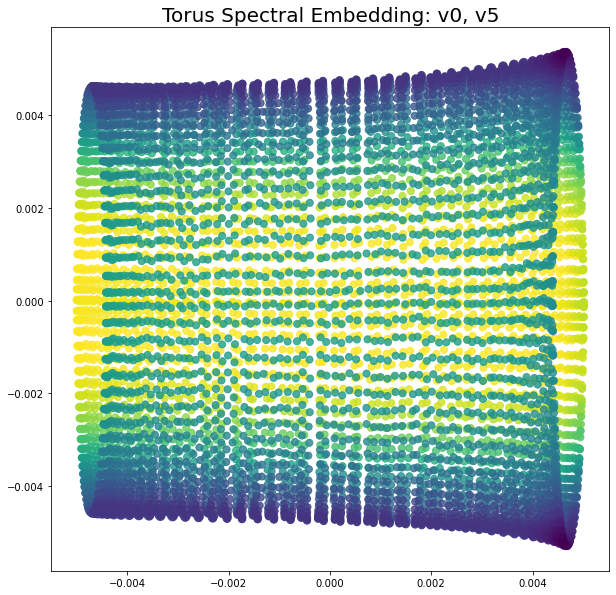

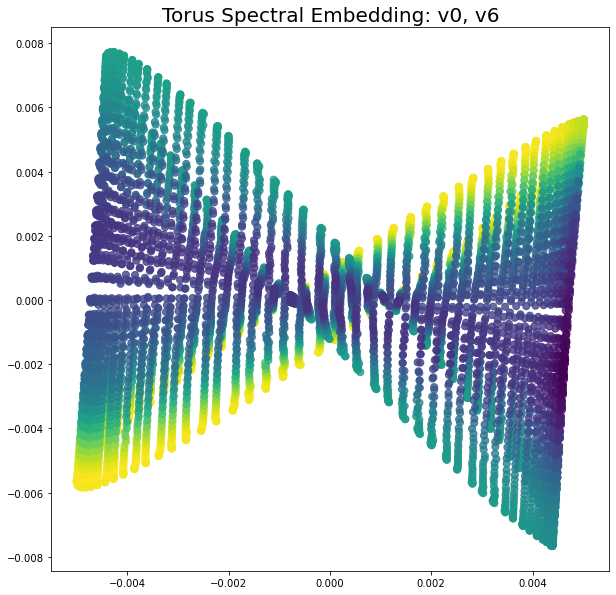

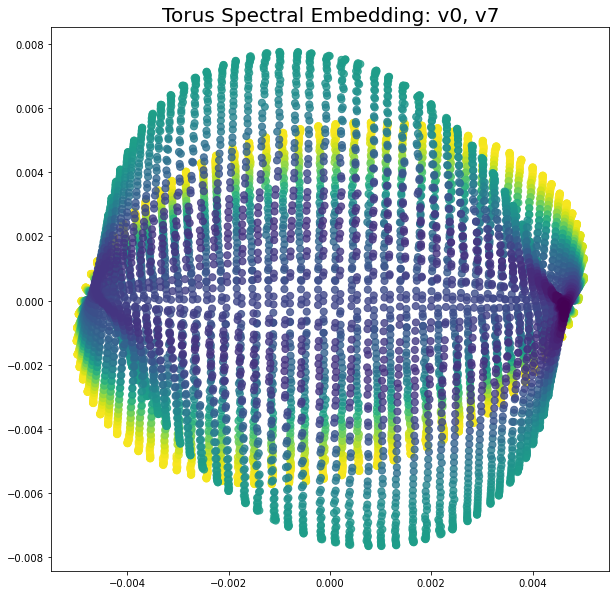

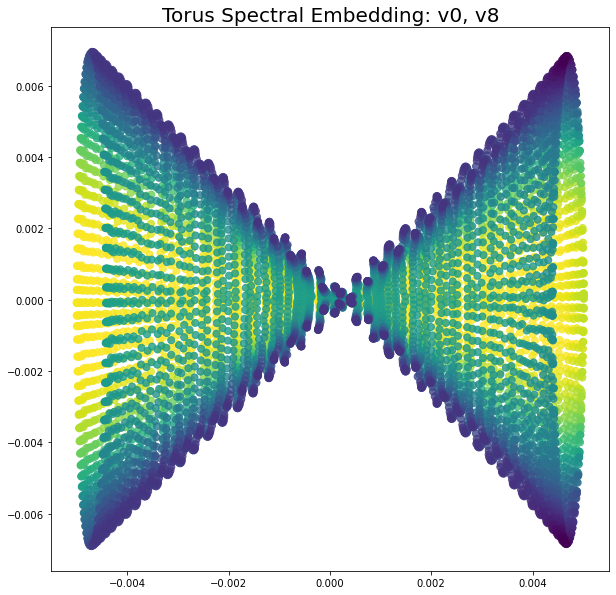

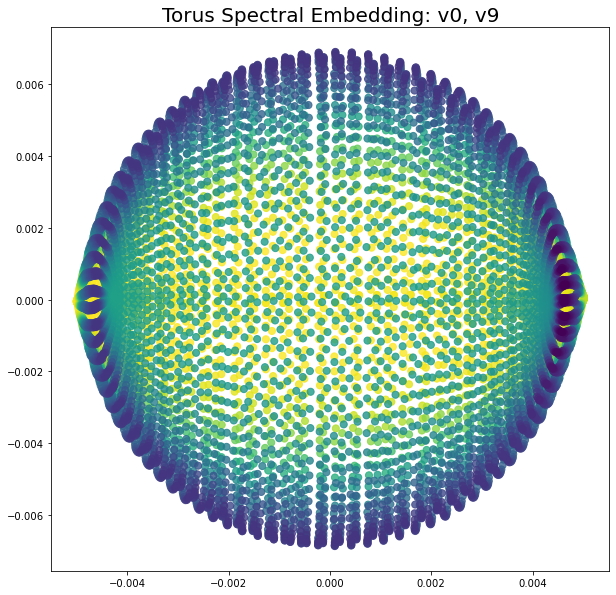

In [59]:
# Spectral embedding
n_neighbors = 12
n_components = 10
spectral = manifold.SpectralEmbedding(n_components=n_components, n_neighbors=n_neighbors)
data_spectral = spectral.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_spectral[:, [0,i]], color,
        shape_name + " Spectral Embedding:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Spectral_Embedding_" + "_v0_" + "_v" + str(i) + ".jpg")

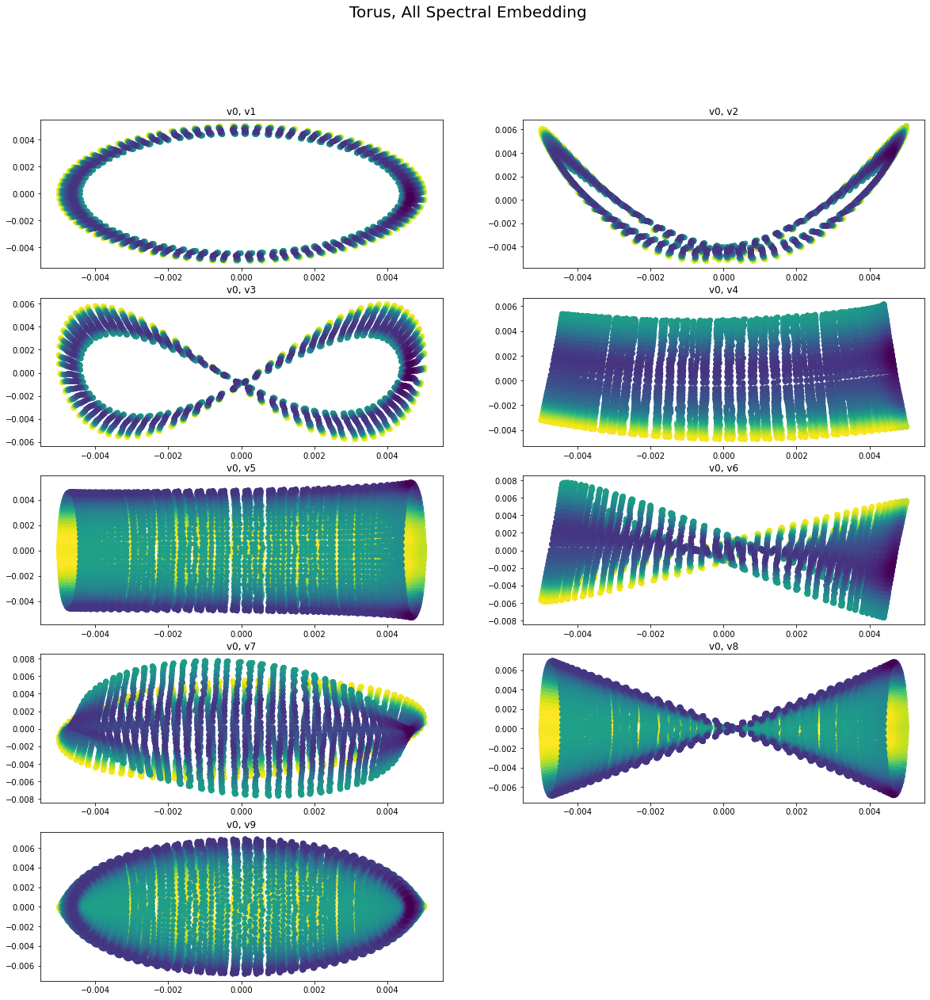

In [61]:
# all combinations, in one plot
plot_2d_shape_all(data_spectral, color, "Torus, All Spectral Embedding",
    save_path=plot_path + "\\" + shape_name + "_All_Spectral_Embedding.jpg")

We can see that among all combinations of Spectral Embedding results for Torus, **(v0, v4)** columns gives the best result, very similar to a trapezoid, a shape in 2d. In comparison, the resulting plot of (v0, v9) is more similar to a spindle in 3d.

In [76]:
# save parameters into txt
np.savetxt(param_path+"\\Torus_Spectral_Embedding.txt", data_spectral[:, [0,4]])

**Circle, Isomap**

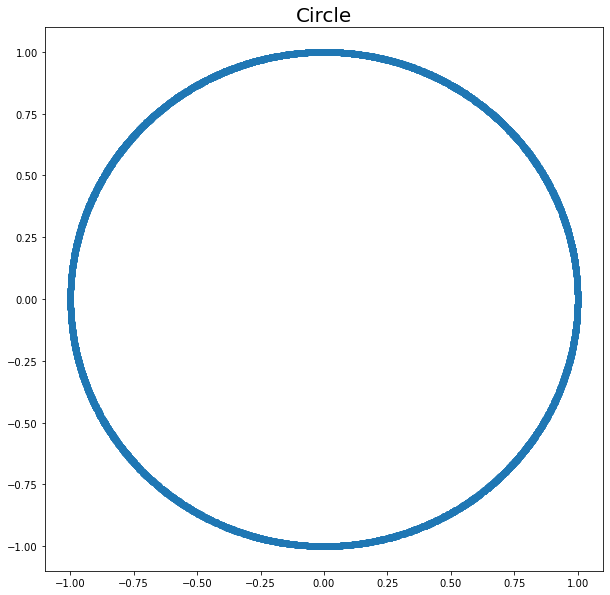

In [64]:
shape_name = "Circle"


def circle(n):
    """
    parameters
        n: number of datapoints used to generate circle
    post
        Return x, y as datapoints of a generated circle;
        x: x coordinates; y: y coordinates.
    """
    x = []
    y = []
    for i in range(0, n):
        angle = random.uniform(0,1) * (math.pi*2)
        x.append(math.cos(angle))
        y.append(math.sin(angle))
    return x, y


# generate datapoints
n = 5000
x, y = circle(n)
circle = [x, y]
circle = np.reshape(circle, (2,n))
circle = np.append(circle, [[0]*n]*18, 0)
data = circle.T

# display and save the generated shape
plt.figure(figsize=(10, 10))
plt.scatter(circle[0,:], circle[1,:])
plt.title("Circle", fontsize=20)
plt.savefig(plot_path + "\\" + shape_name + ".jpg")
plt.show()

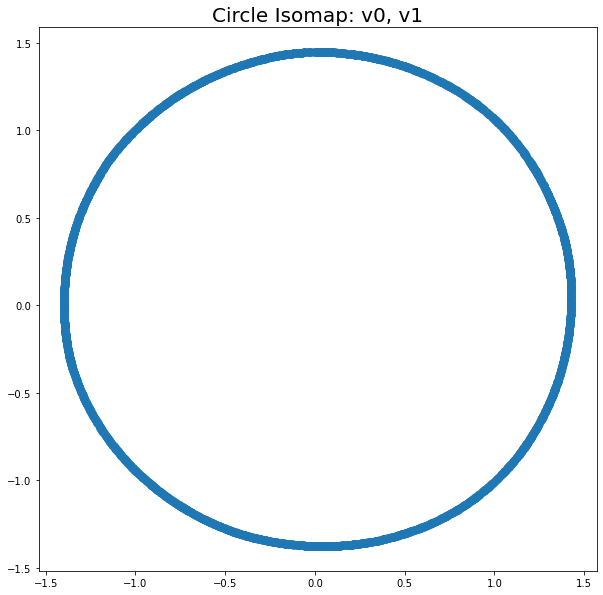

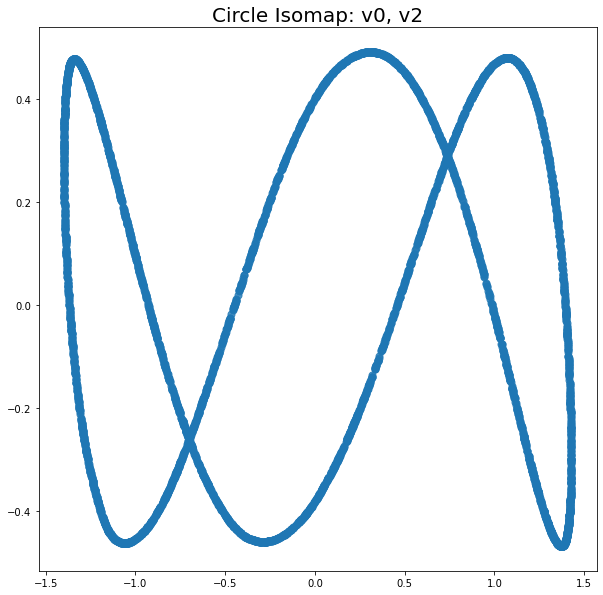

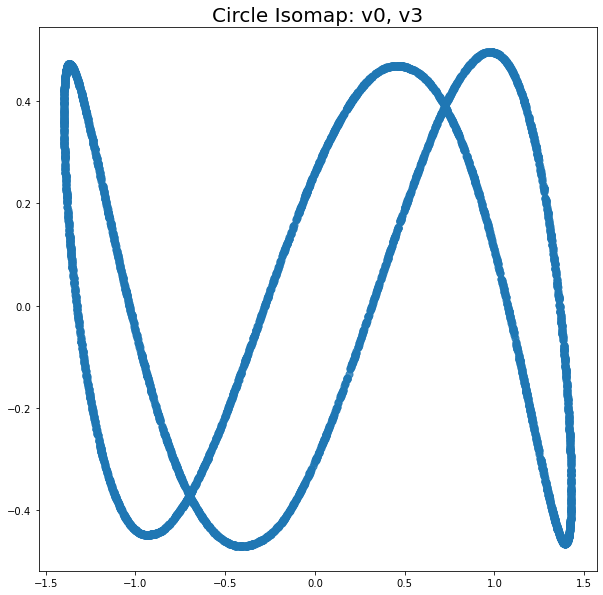

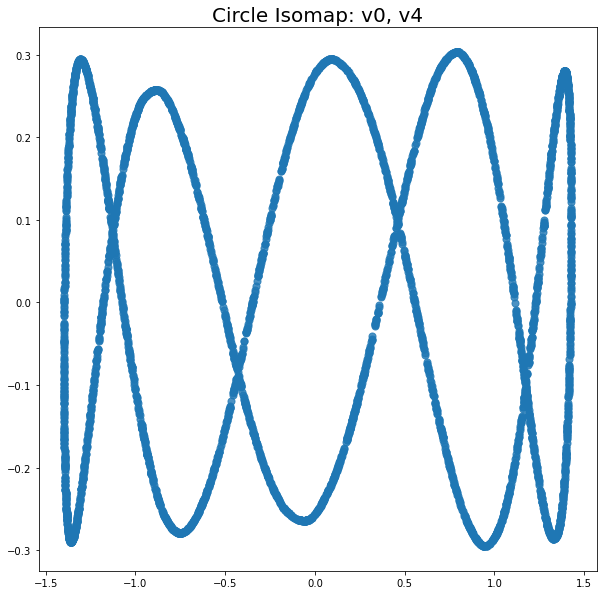

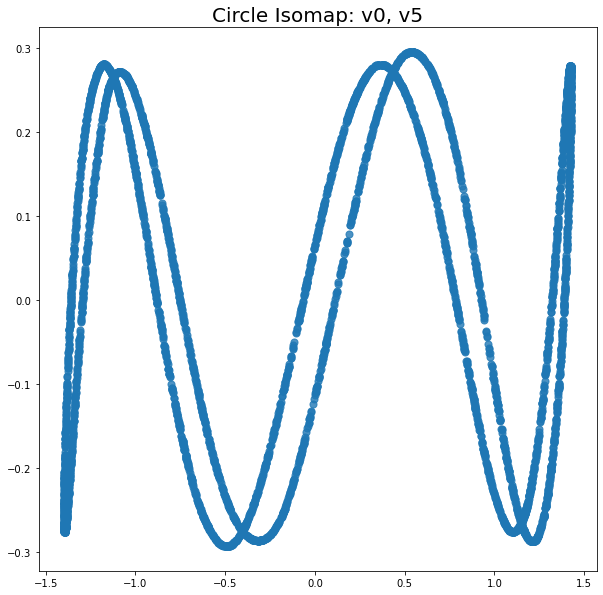

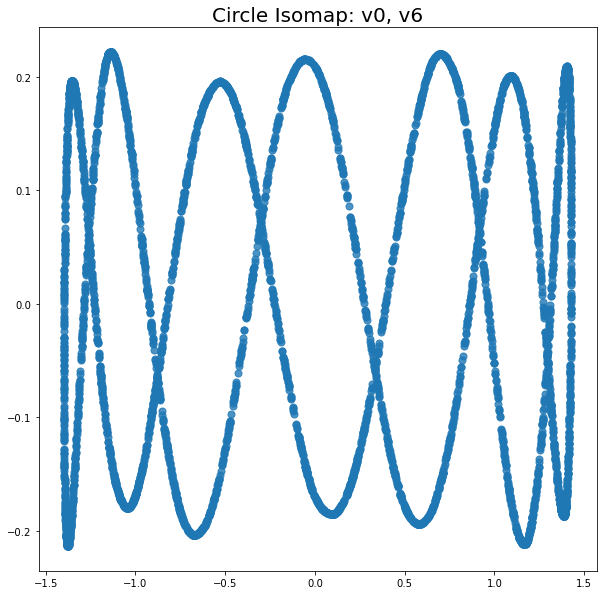

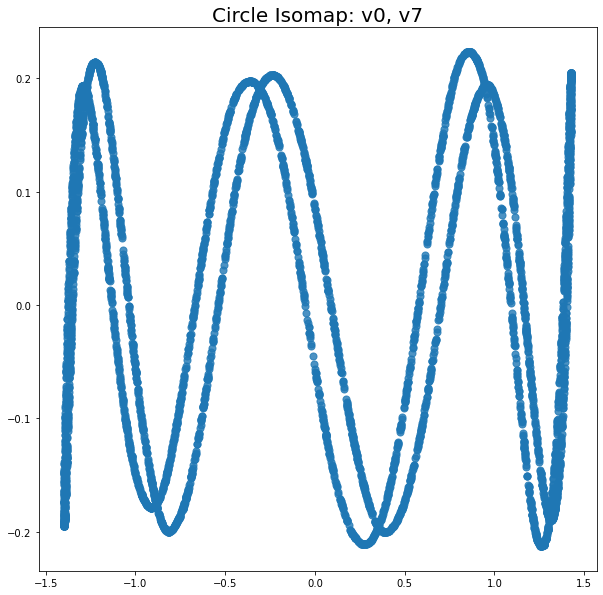

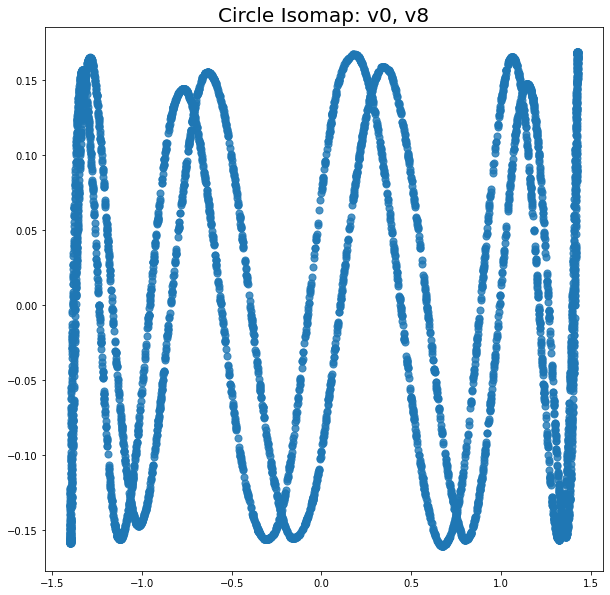

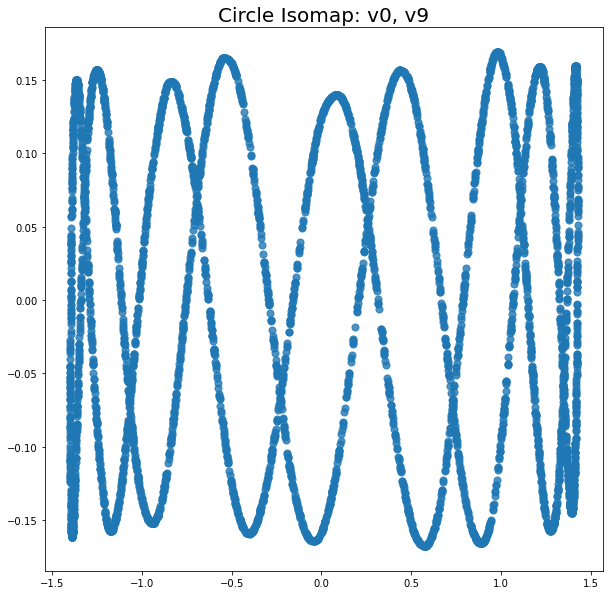

In [70]:
# Isomap embedding
n_neighbors = 12
n_components = 10
isomap = manifold.Isomap(n_neighbors=n_neighbors, n_components=n_components)
data_isomap = isomap.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_isomap[:, [0,i]], None,
        shape_name + " Isomap:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Isomap_" + "_v0_" + "_v" + str(i) + ".jpg")

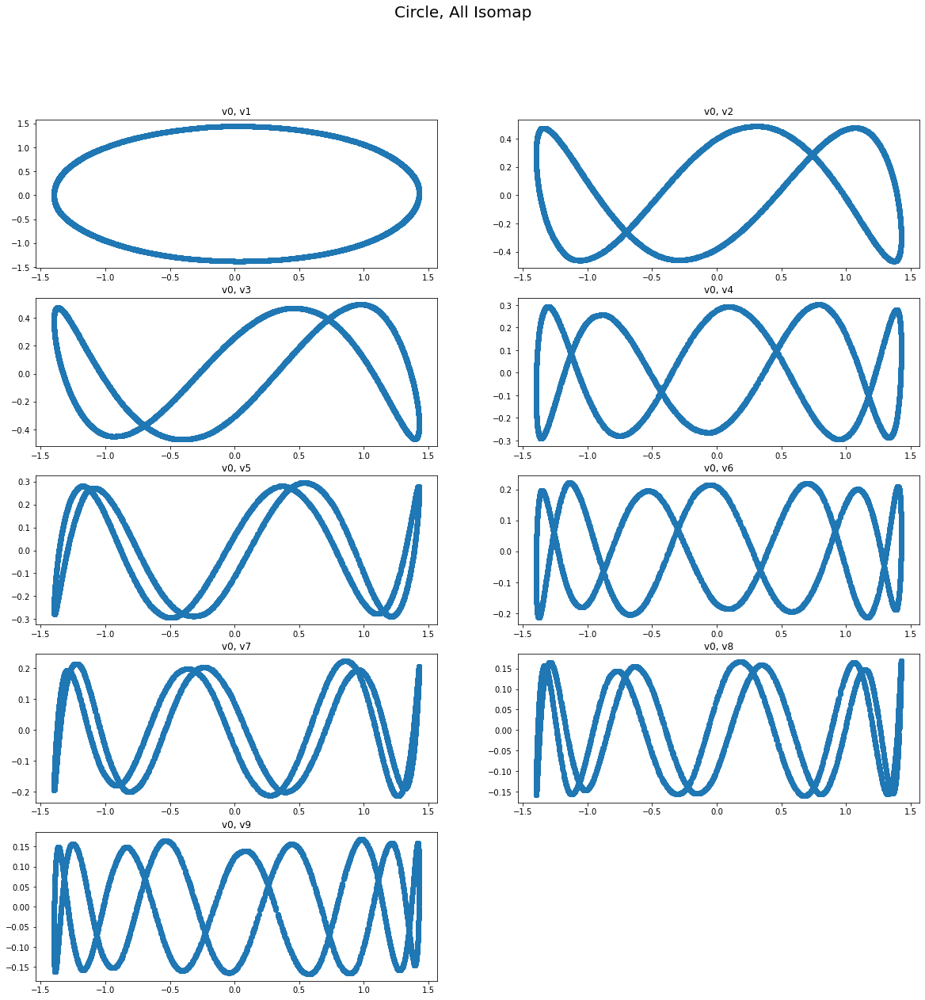

In [72]:
# all combinations, in one plot
plot_2d_shape_all(data_isomap, None, "Circle, All Isomap",
    save_path=plot_path + "\\" + shape_name + "_All_Isomap.jpg")

We can see that among all combinations of Isomap results for Circle, **(v0, v1)** columns gives the best result, a shape in 2d.

In [77]:
# save parameters into txt
np.savetxt(param_path+"\\Circle_Isomap.txt", data_isomap[:, [0,1]])

**Circle, Spectral Embedding**

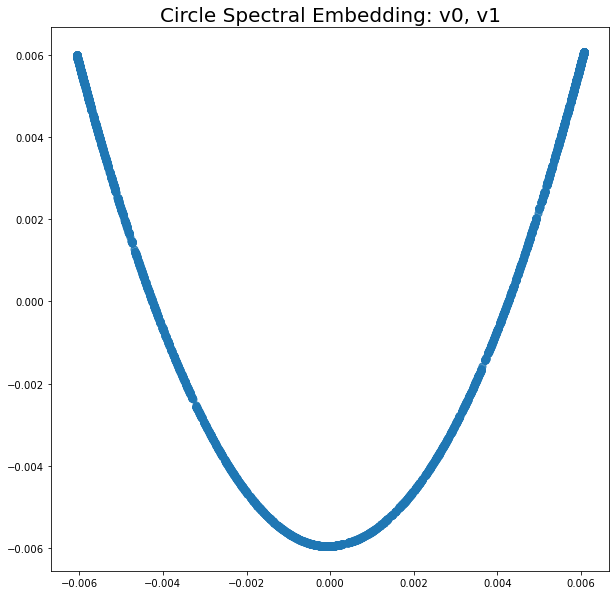

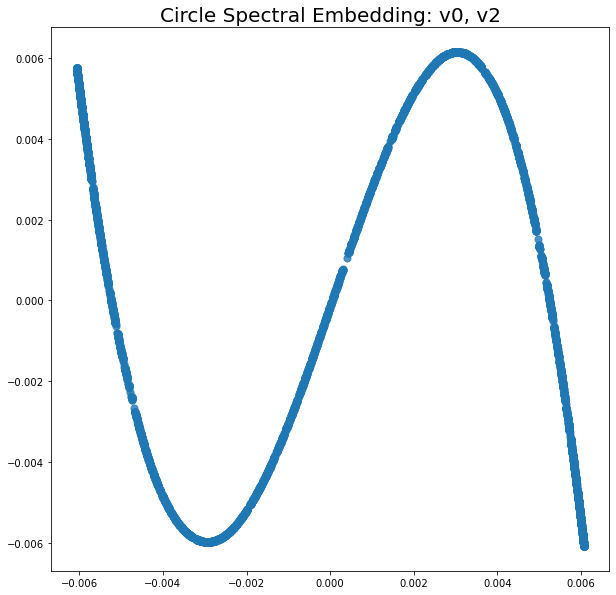

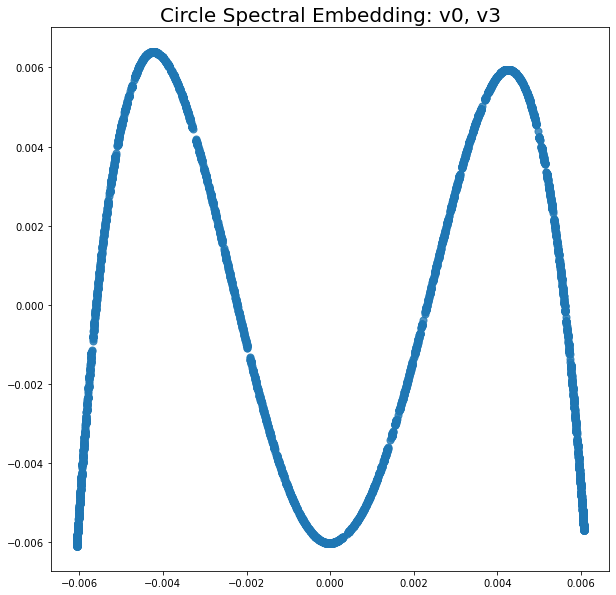

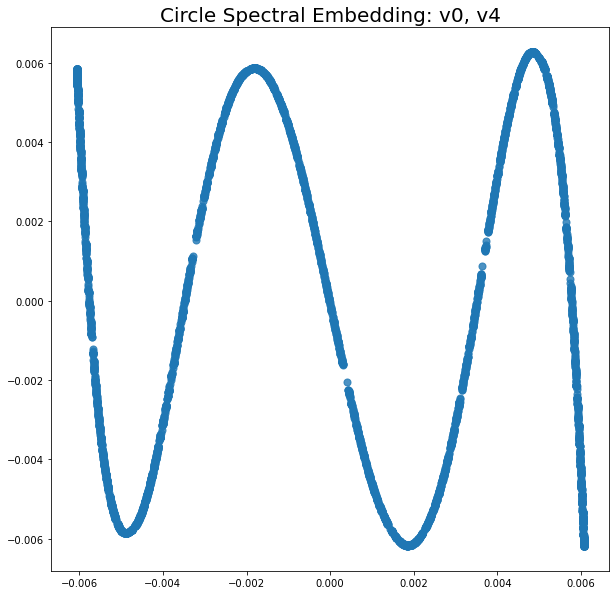

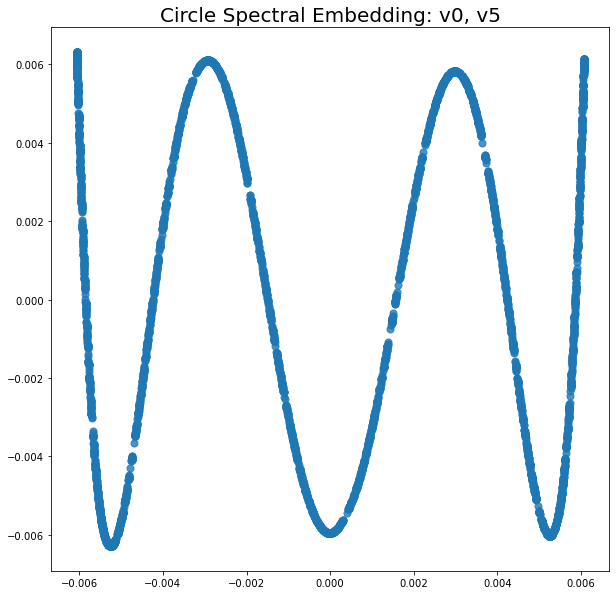

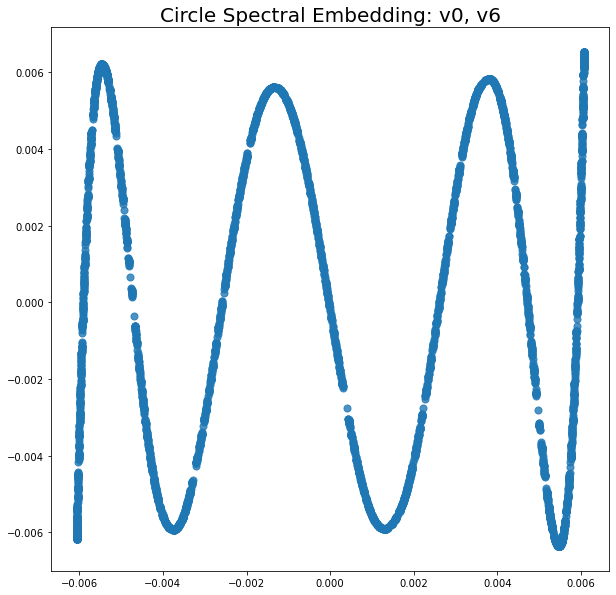

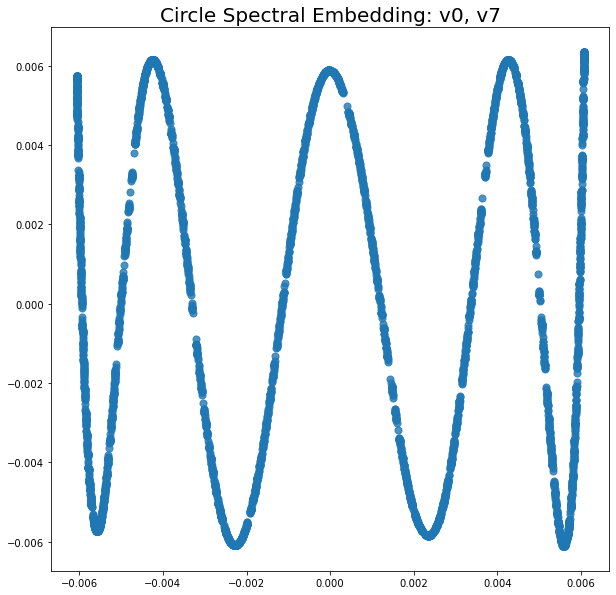

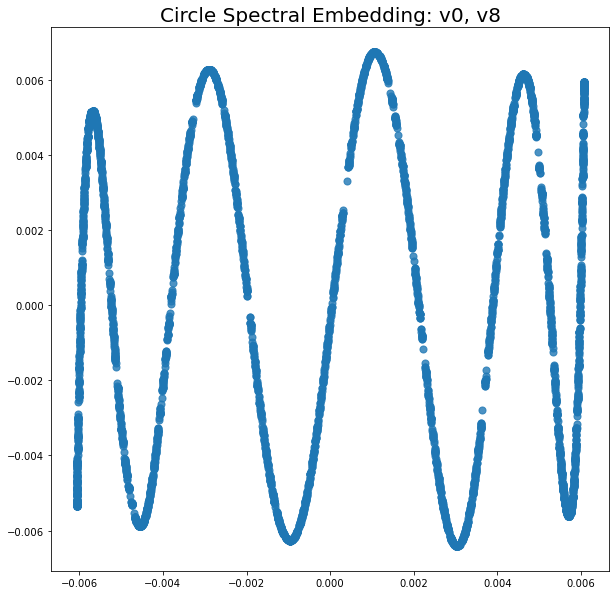

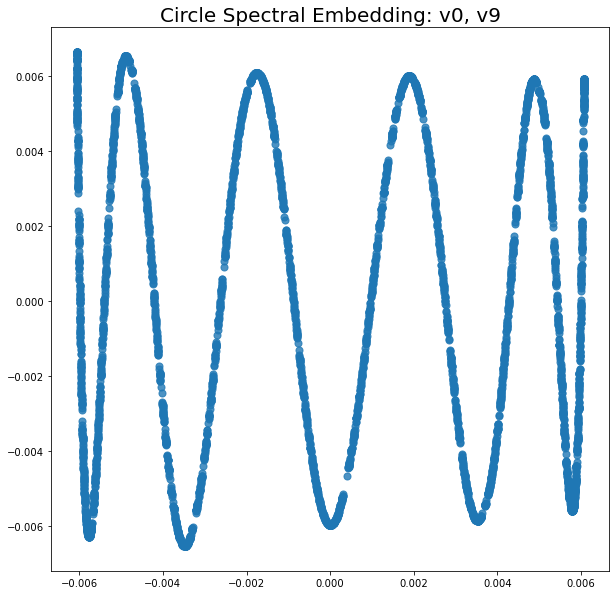

In [78]:
# Spectral embedding
n_neighbors = 12
n_components = 10
spectral = manifold.SpectralEmbedding(n_components=n_components, n_neighbors=n_neighbors)
data_spectral = spectral.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_spectral[:, [0,i]], None,
        shape_name + " Spectral Embedding:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Spectral_Embedding_" + "_v0_" + "_v" + str(i) + ".jpg")

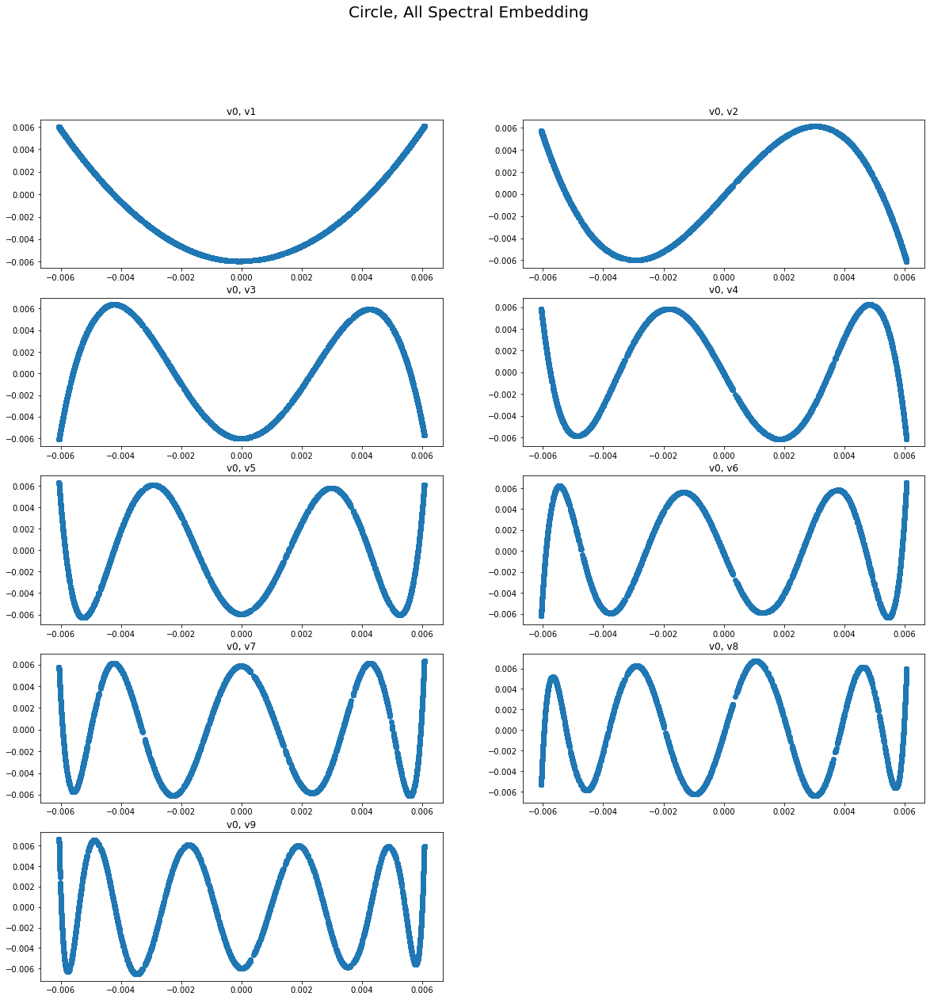

In [79]:
# all combinations, in one plot
plot_2d_shape_all(data_spectral, None, "Circle, All Spectral Embedding",
    save_path=plot_path + "\\" + shape_name + "_All_Spectral_Embedding.jpg")

We can see that among all combinations of Spectral Embedding results for Circle, none of them gives a resulting plot similar to a 2d shape; thus, none of them is good result.

**Rectangle, Isomap**

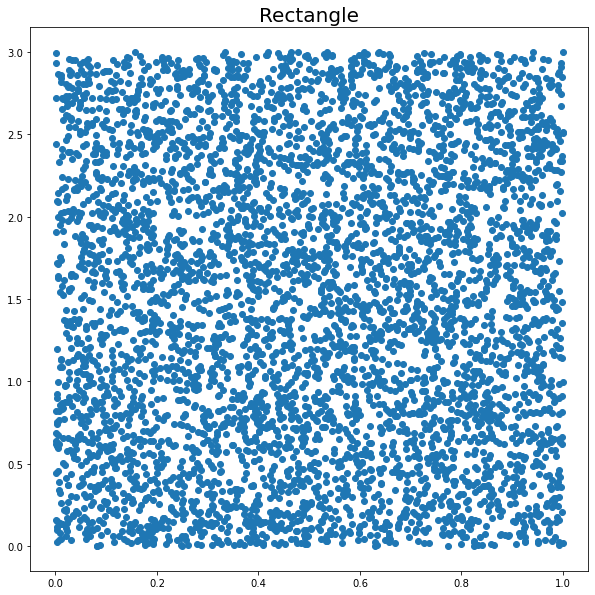

In [89]:
shape_name = "Rectangle"

# generate datapoints
n = 5000
xs = []
ys = []
for i in range(n):
    xs.append(random.uniform(0, 1))
    ys.append(random.uniform(0, 3))
data = np.array([xs, ys]).T

# display and save the generated shape
plt.figure(figsize=(10, 10))
plt.scatter(data[:,0], data[:,1])
plt.title("Rectangle", fontsize=20)
plt.savefig(plot_path + "\\" + shape_name + ".jpg")
plt.show()

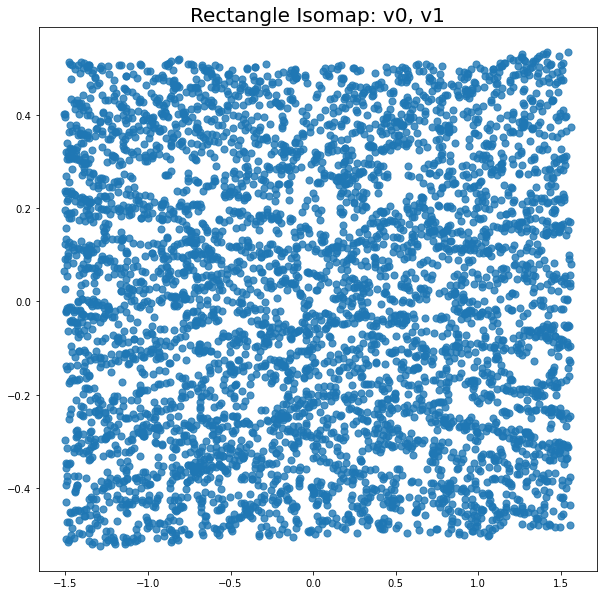

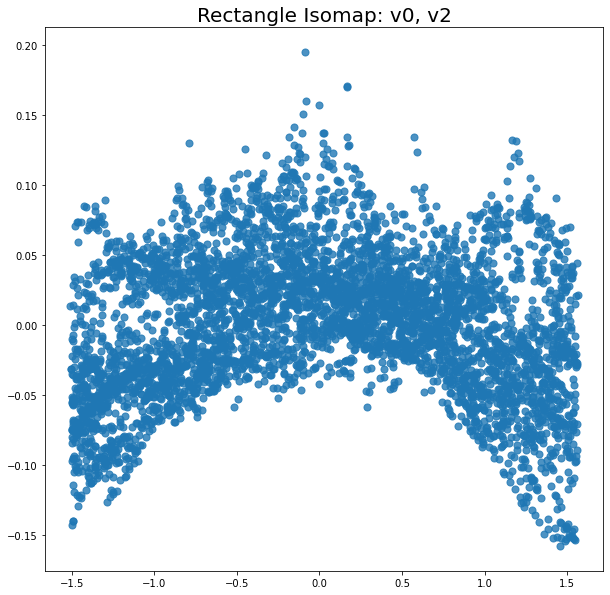

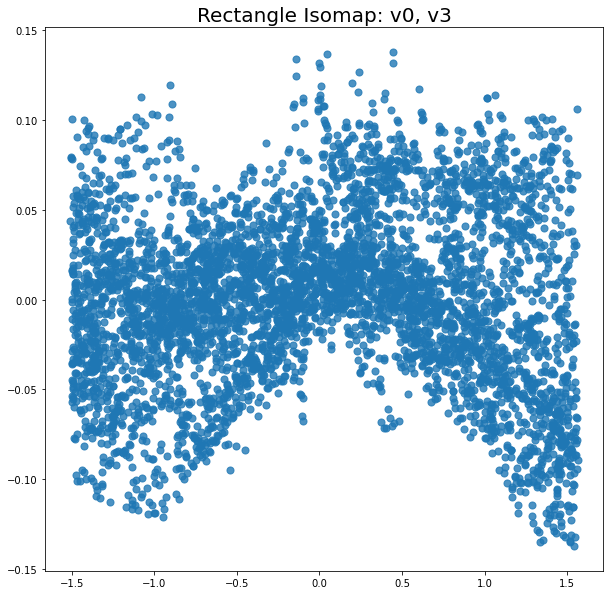

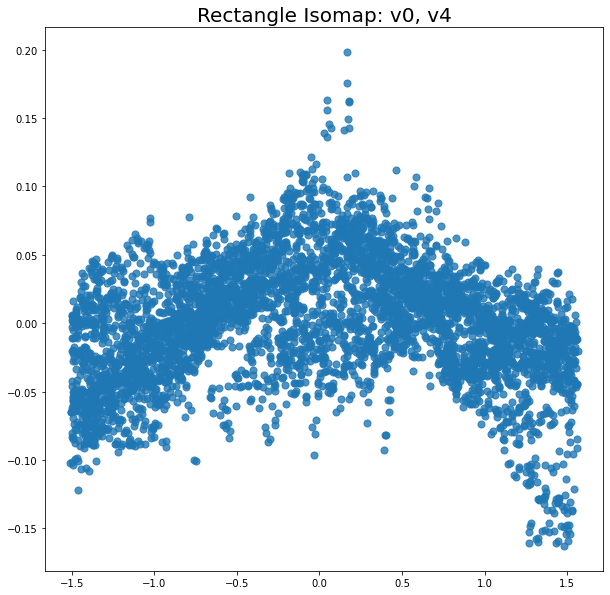

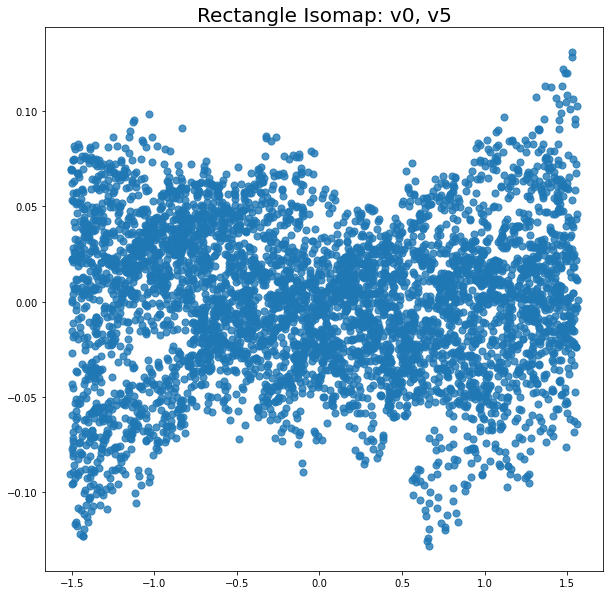

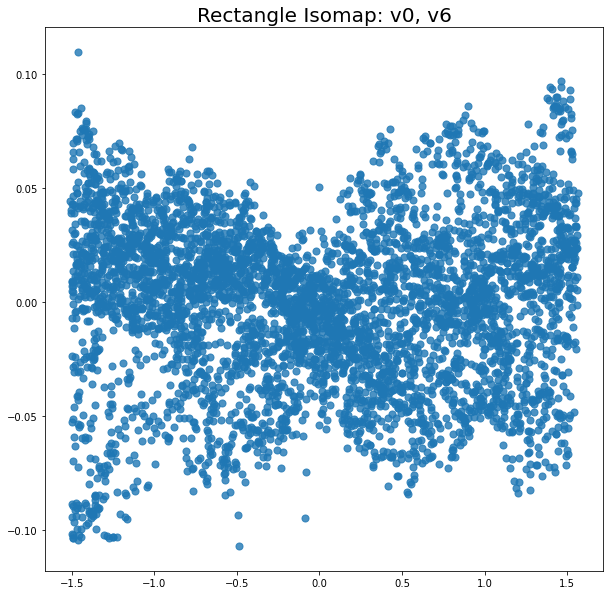

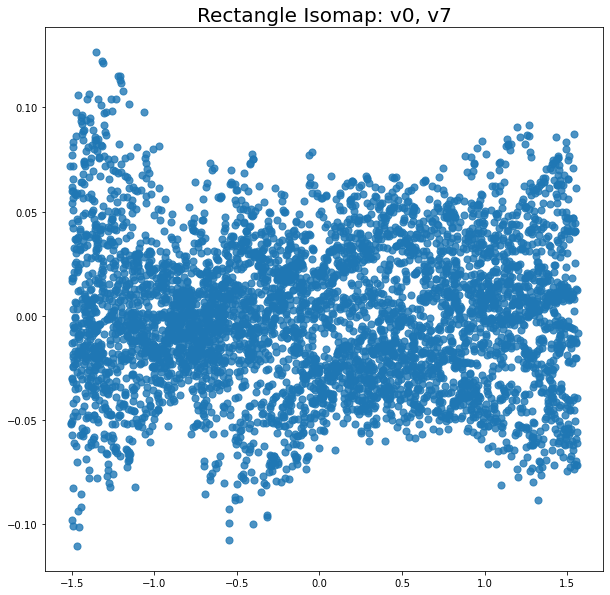

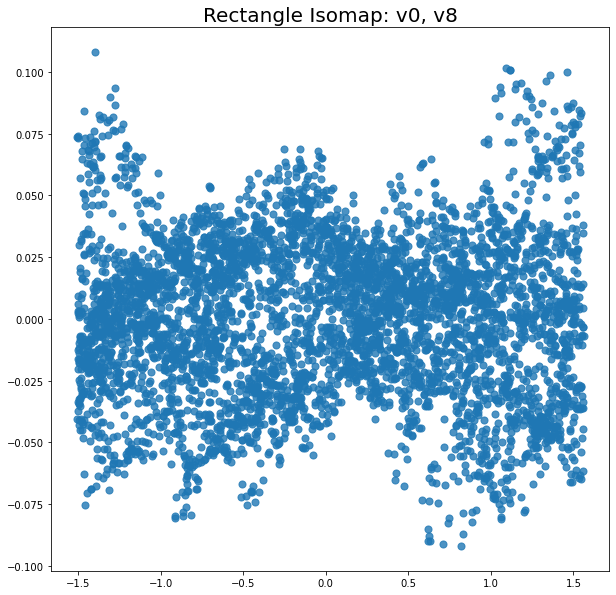

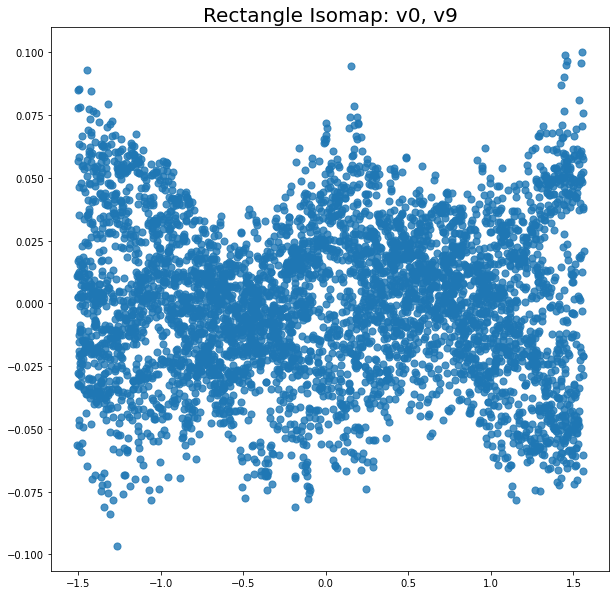

In [90]:
# Isomap embedding
n_neighbors = 12
n_components = 10
isomap = manifold.Isomap(n_neighbors=n_neighbors, n_components=n_components)
data_isomap = isomap.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_isomap[:, [0,i]], None,
        shape_name + " Isomap:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Isomap_" + "_v0_" + "_v" + str(i) + ".jpg")

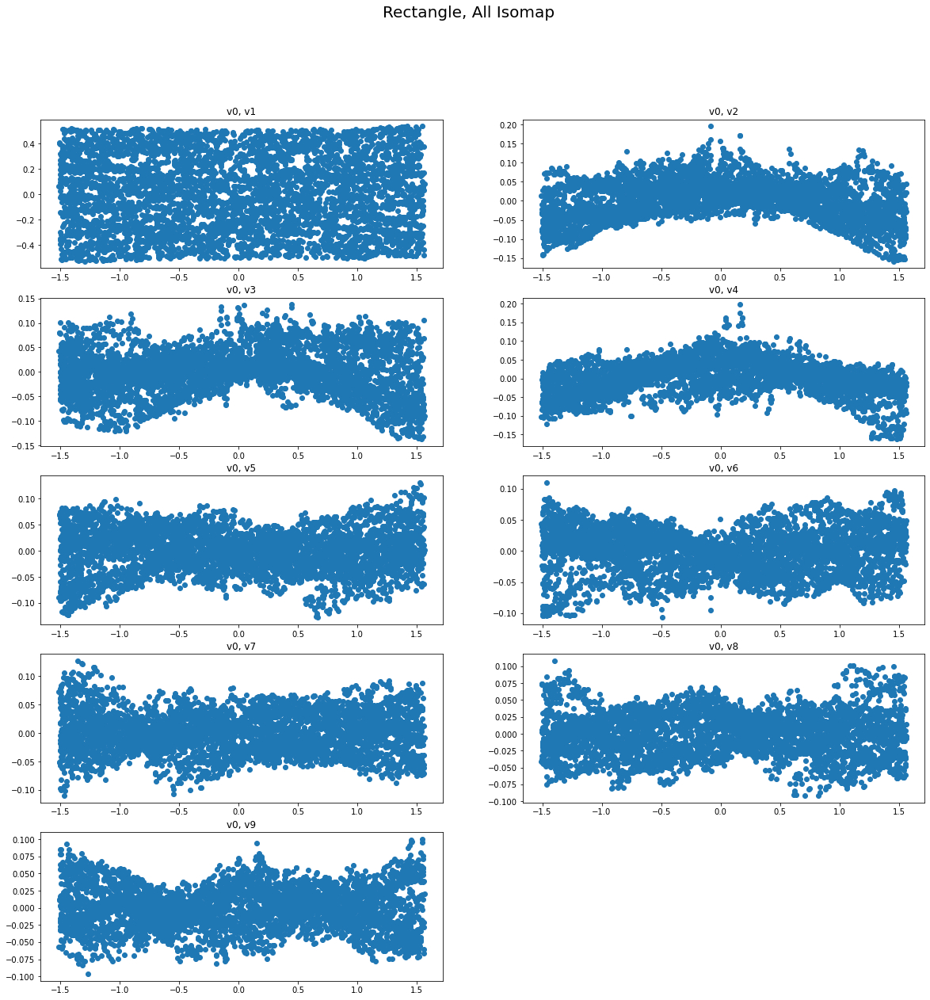

In [91]:
# all combinations, in one plot
plot_2d_shape_all(data_isomap, None, "Rectangle, All Isomap",
    save_path=plot_path + "\\" + shape_name + "_All_Isomap.jpg")

We can see that among all combinations of Isomap results for Rectangle, **(v0, v1)** columns gives the best result, a shape in 2d.

In [92]:
# save parameters into txt
np.savetxt(param_path+"\\Rectangle_Isomap.txt", data_isomap[:, [0,1]])

**Rectangle, Spectral Embedding**

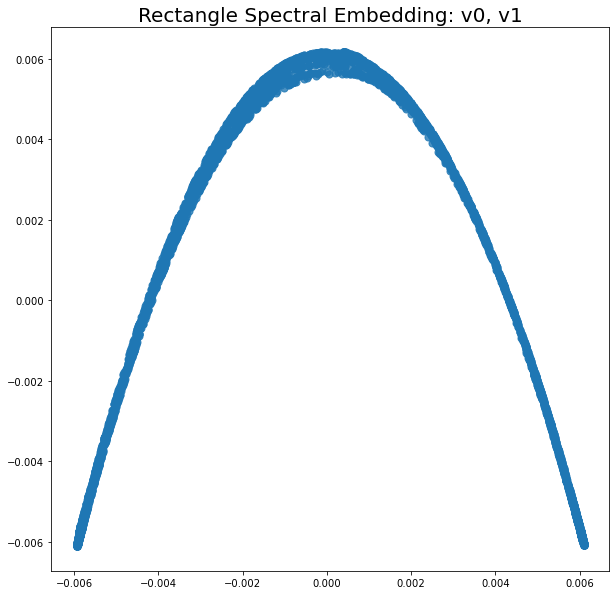

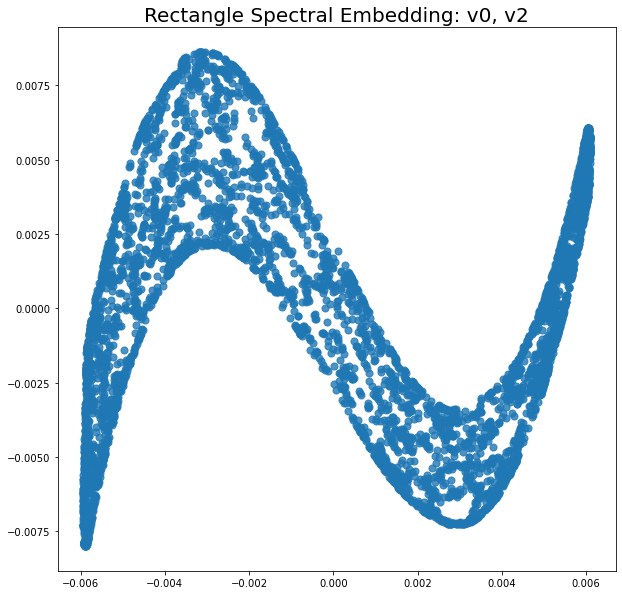

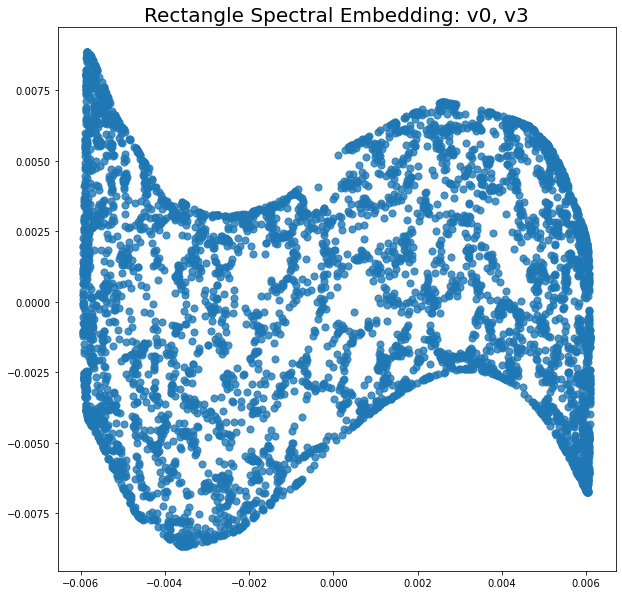

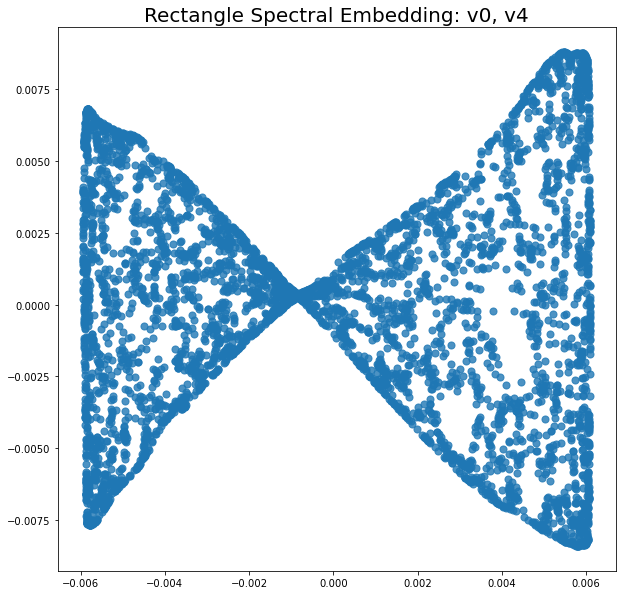

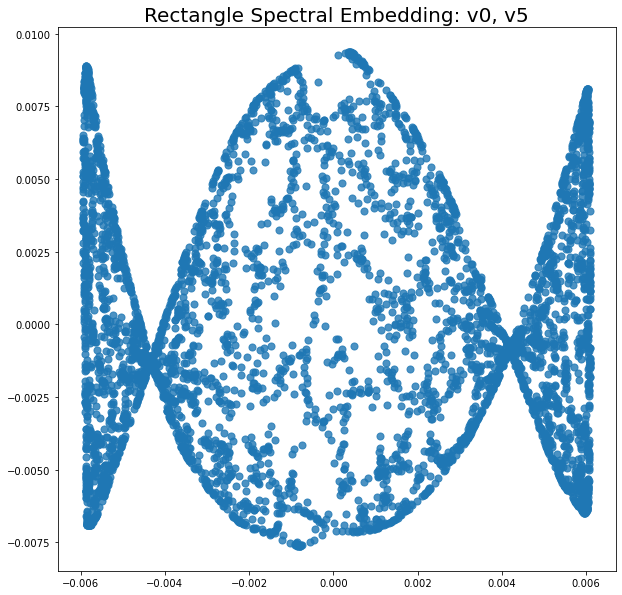

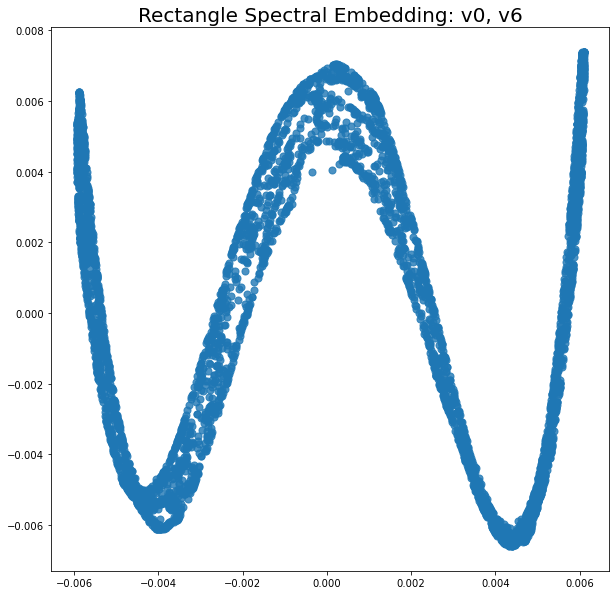

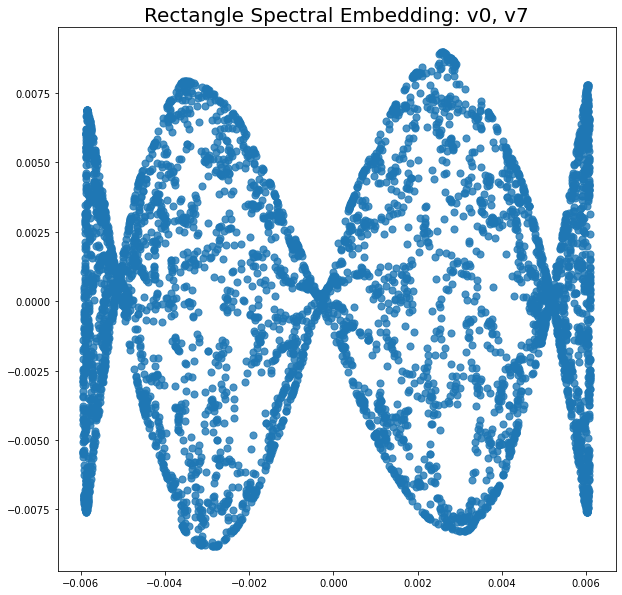

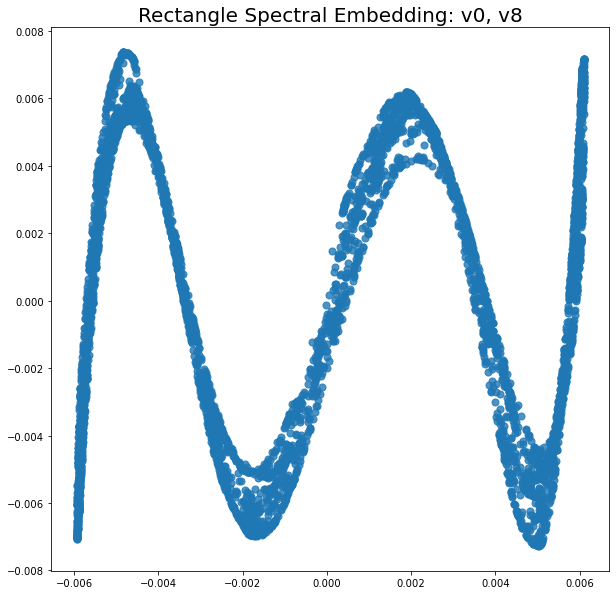

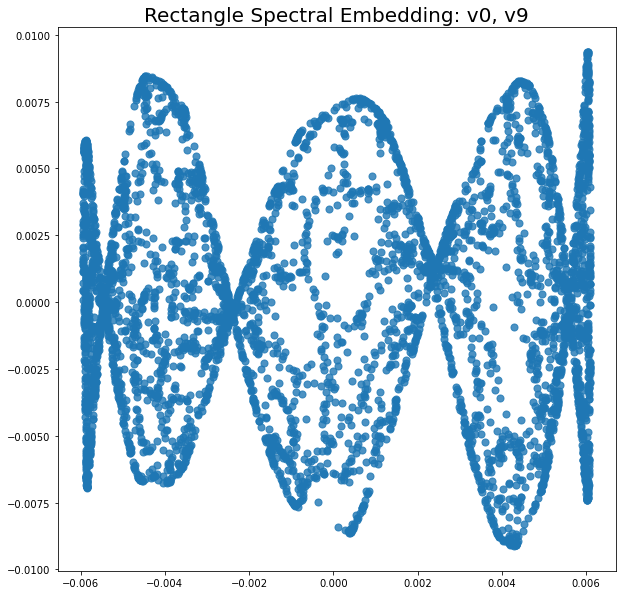

In [93]:
# Spectral embedding
n_neighbors = 12
n_components = 10
spectral = manifold.SpectralEmbedding(n_components=n_components, n_neighbors=n_neighbors)
data_spectral = spectral.fit_transform(data)

# show and save plots of all combinations
for i in range(1, n_components):
    plot_2d_shape_single(data_spectral[:, [0,i]], None,
        shape_name + " Spectral Embedding:" + " v0," + " v" + str(i),
        save_path=plot_path + "\\" + shape_name + "_Spectral_Embedding_" + "_v0_" + "_v" + str(i) + ".jpg")

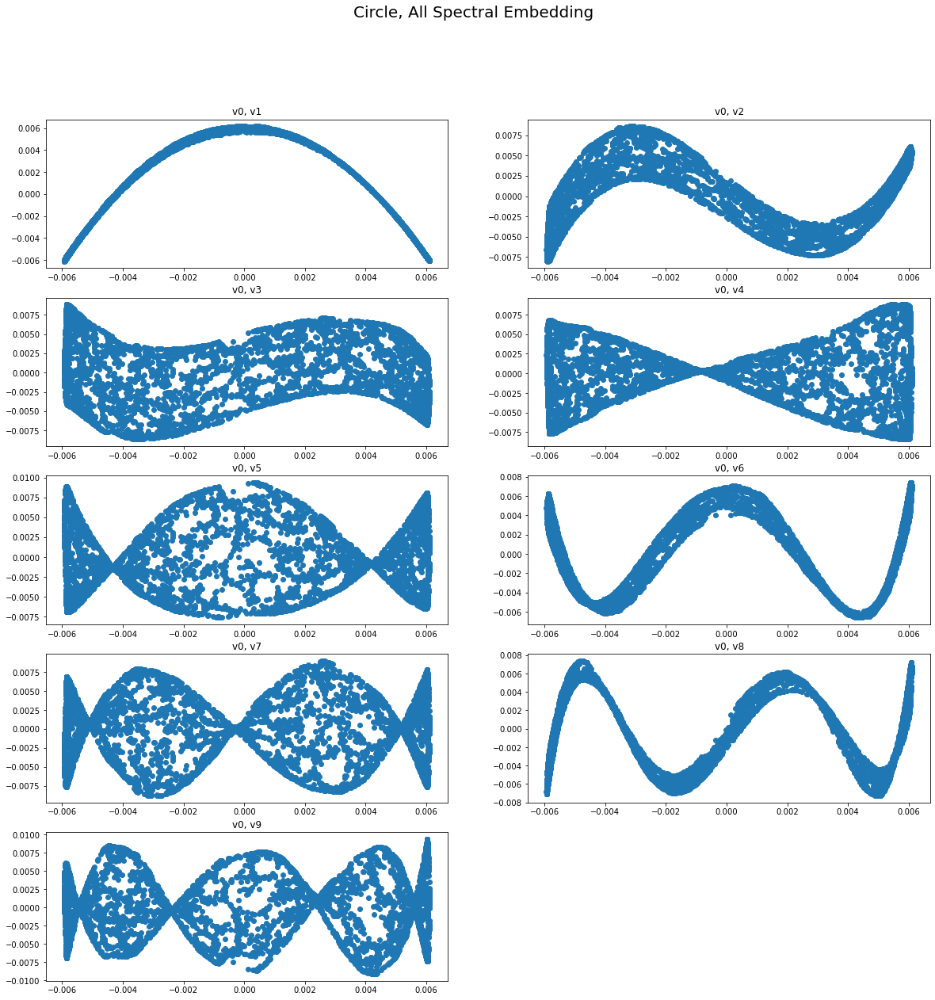

In [94]:
# all combinations, in one plot
plot_2d_shape_all(data_spectral, None, "Circle, All Spectral Embedding",
    save_path=plot_path + "\\" + shape_name + "_All_Spectral_Embedding.jpg")

We can see that among all combinations of Spectral Embedding results for Rectangle, **(v0, v2)** columns gives the best result, most similar to a shape in 2d.

In [95]:
# save parameters into txt
np.savetxt(param_path+"\\Rectangle_Spectral_Embedding.txt", data_spectral[:, [0,2]])